<a href="https://colab.research.google.com/github/HansGV1/Trabajo-01-OptimizacionHeurstica-RNA-y-Algo-Bioinsp/blob/main/Trabajo_1_Redes_Neuronales_y_Algoritmos_Bioinspirados.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Trabajo 01: Optimización heurística

Fecha: 03/12/2024

Asingatura: Redes Neuronales y Algoritmos Bioinspirados - RNA

Profesor: Juan David Ospina Arango

Facultad de Minas

Universidad Nacional de Colombia

Grupo: 8

Integrantes:
- Hans Guillermo García Vargas - hggarciav@unal.edu.co
- Daniel Metaute Medina - dmetaute@unal.edu.co
- Juan Sebastián Zapata Echeverri - jzapataec@unal.edu.co
- Juan José Monsalve Marín - jjmonsalvem@unal.edu.co


## Parte 1: Optimización numérica

Considere las siguientes funciones de prueba:

    Función de Rosenbrock
    Función de Rastrigin
    Función de Schwefel.
    Función de Griewank
    Función Goldstein-Price
    Función de las seis jorobas de camello ()

### 1. Escoja dos funciones de prueba






```
De acuerdo con la lista provista de funciones se seleccionan las siguientes dos funciones de prueba:

A. Función Rosenbrock
B. Función Rastrigin
```



### 2. Optimice las funciones en dos y tres dimensiones usando un método de descenso por gradiente con condición inicial aleatoria.

#### Optimización de funciones de prueba - Método de desenso por gradiante con condición inicial aleatoria.

##### Función Rosenbrock (Rosenbrock function) - 2 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

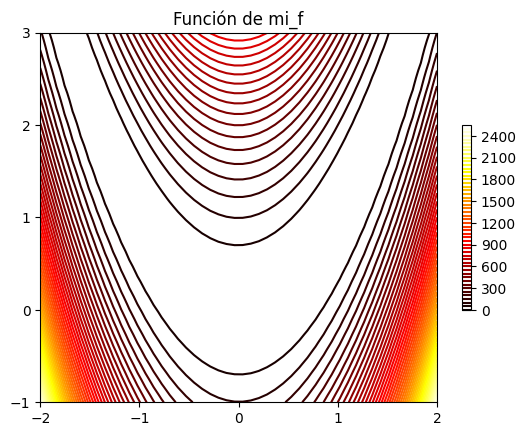

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

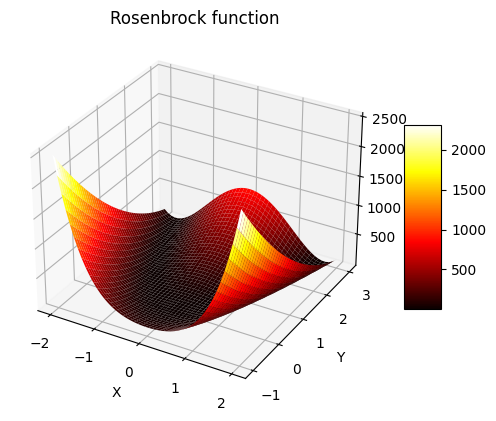

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

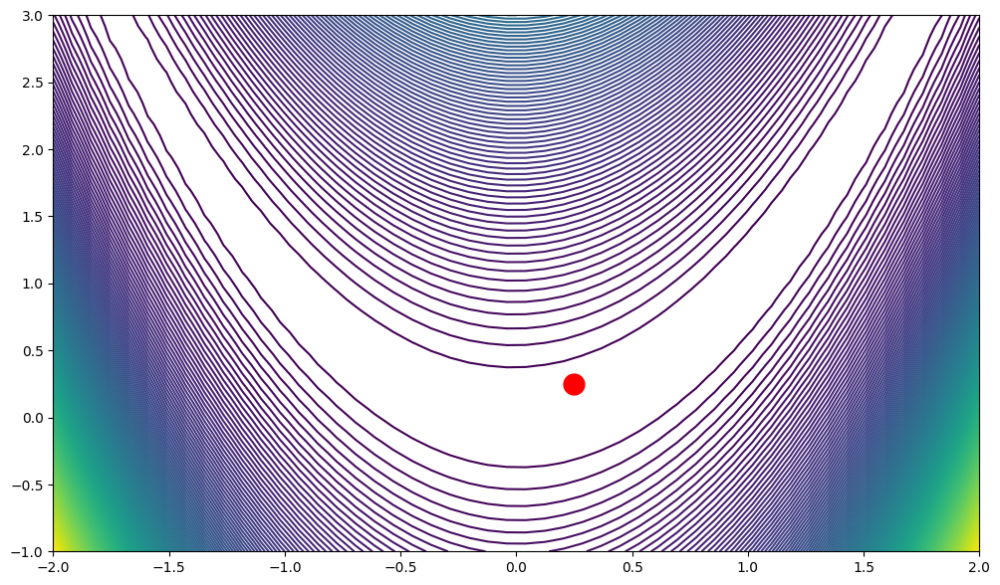

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-7-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-7-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

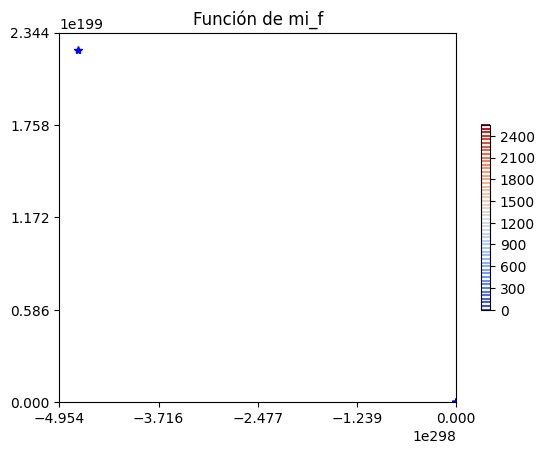

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


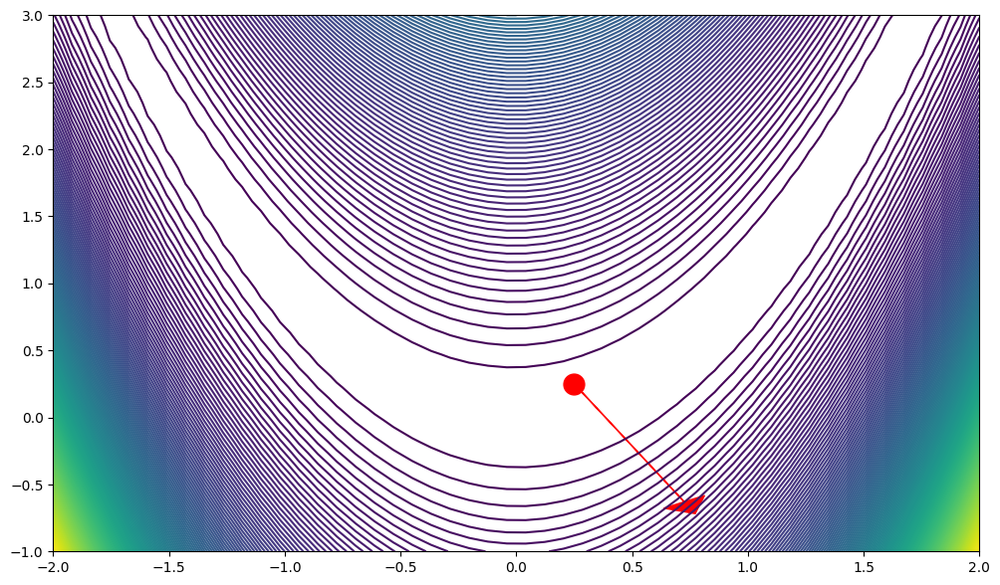

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


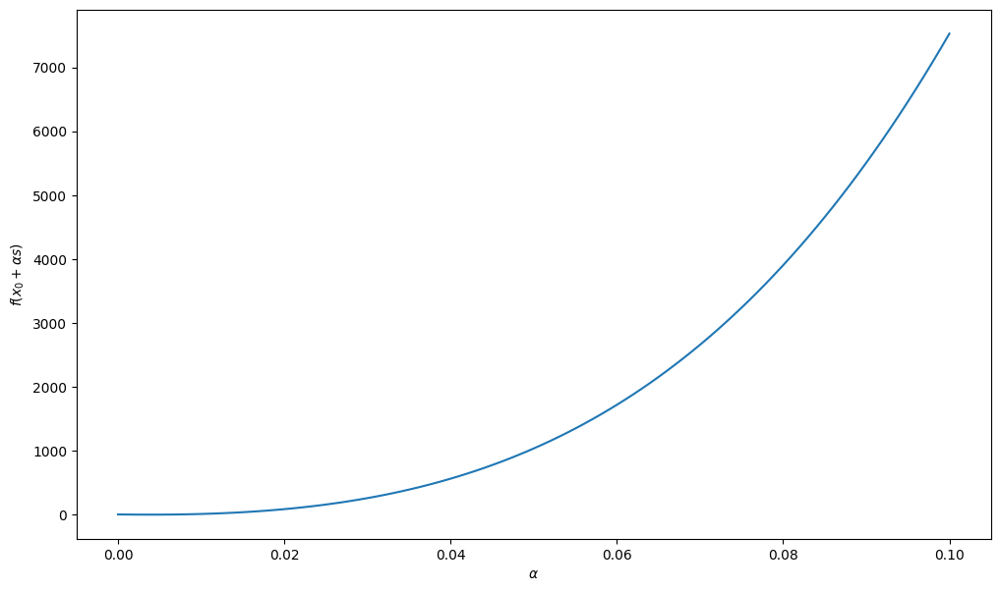

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

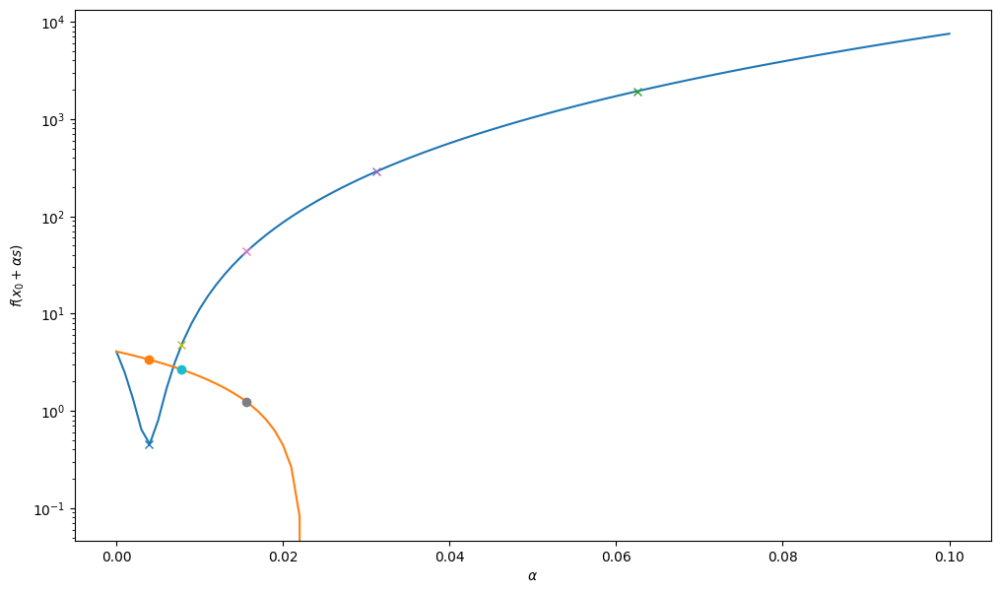

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

gen	nevals
0  	50    
1  	29    
2  	40    
3  	31    
4  	31    
5  	24    
6  	31    
7  	30    
8  	25    
9  	31    
10 	33    
11 	25    
12 	33    
13 	36    
14 	33    
15 	33    
16 	33    
17 	27    
18 	23    
19 	37    
20 	28    
21 	36    
22 	36    
23 	33    
24 	26    
25 	30    
26 	32    
27 	25    
28 	27    
29 	33    
30 	22    
31 	28    
32 	36    
33 	31    
34 	32    
35 	32    
36 	30    
37 	34    
38 	39    
39 	34    
40 	33    
41 	26    
42 	29    
43 	27    
44 	29    
45 	33    
46 	25    
47 	27    
48 	36    
49 	27    
50 	30    
51 	27    
52 	30    
53 	17    
54 	32    
55 	40    
56 	28    
57 	27    
58 	33    
59 	30    
60 	27    
61 	25    
62 	30    
63 	33    
64 	26    
65 	43    
66 	23    
67 	37    
68 	26    
69 	28    
70 	29    
71 	36    
72 	25    
73 	32    
74 	21    
75 	35    
76 	30    
77 	29    
78 	28    
79 	27    
80 	31    
81 	23    
82 	34    
83 	30    
84 	32    
85 	26    
86 	34    
87 	20    
88 	32    
89 	27    

##### Función Rastrigin (Rastrigin function) - 2 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
A = 10
x = np.linspace(-5.12, 5.12, 100)
f = A + (x**2 - A * np.cos(2 * np.pi * x))

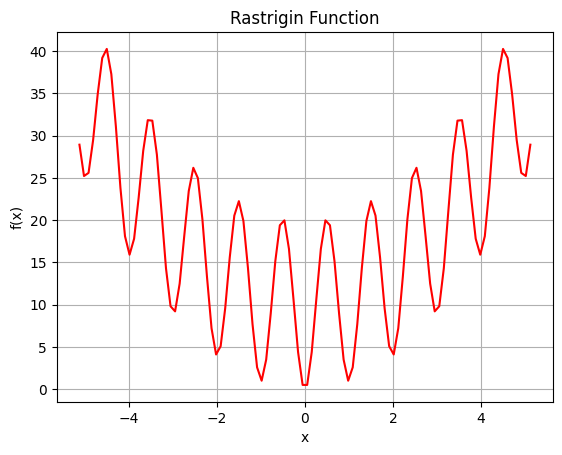

In [ ]:
plt.plot(x, f, 'r-')
plt.title('Rastrigin Function')
plt.xlabel('x')
plt.ylabel('f(x)')
plt.grid()
plt.show()

In [ ]:
def f(x):
  A = 10
  y = A + (x**2 - A * np.cos(2 * np.pi * x))
  return(y)

def df(x):
  A = 10
  y = 2*x + 2*np.pi*A*np.sin(2*np.pi*x)
  return(y)

In [ ]:
def mi_optimizador(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k])
  return(solucion,valor_obj,k)


In [ ]:
sol, f_obj, k = mi_optimizador(x0 = 0.25, g=f, g1p=df, lr = 0.1, tol = 0.0001)

In [ ]:
# Gráfica de la solución
plt.plot(x,y, 'r-',label = 'funcion')
plt.plot(sol,f_obj,'b*', label = 'solucion')
plt.title('Grafíca de $x^2 \cos(x)$')
plt.xlabel('$x$')
plt.legend()
plt.grid()
plt.show()

\#### Función Rosenbrock (Rosenbrock function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

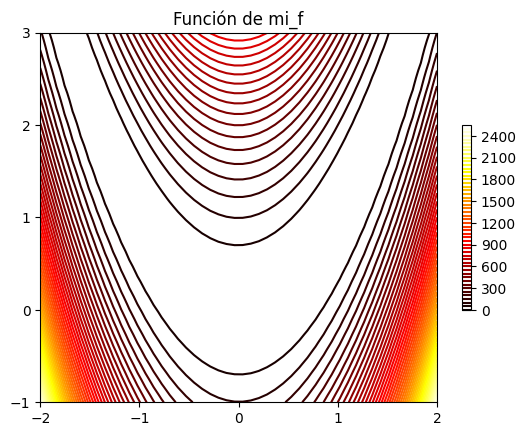

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

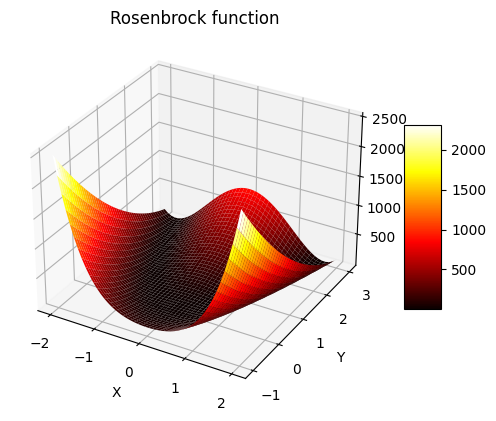

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

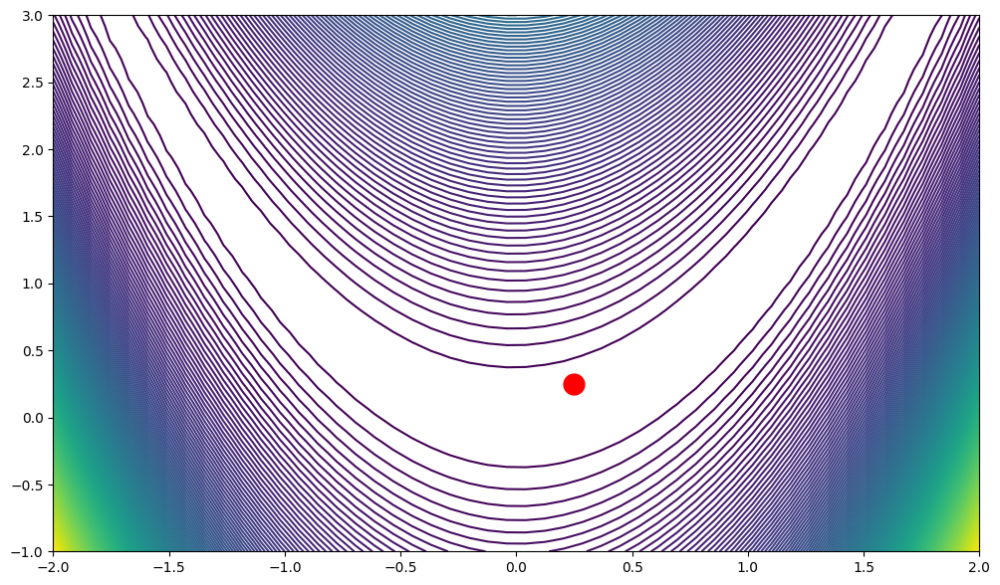

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-7-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-7-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

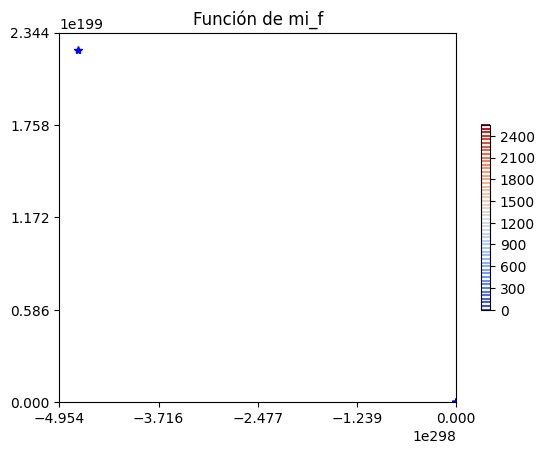

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


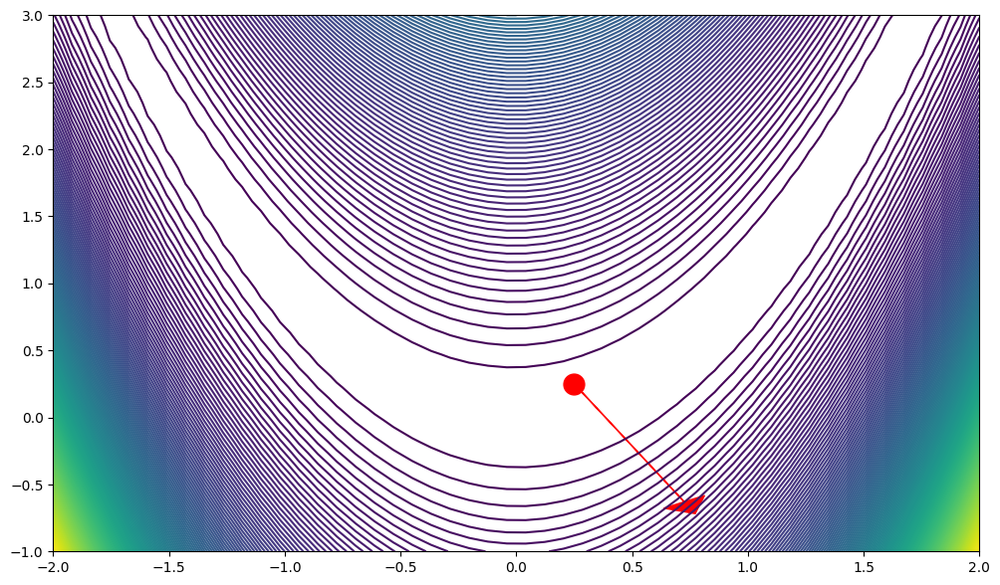

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


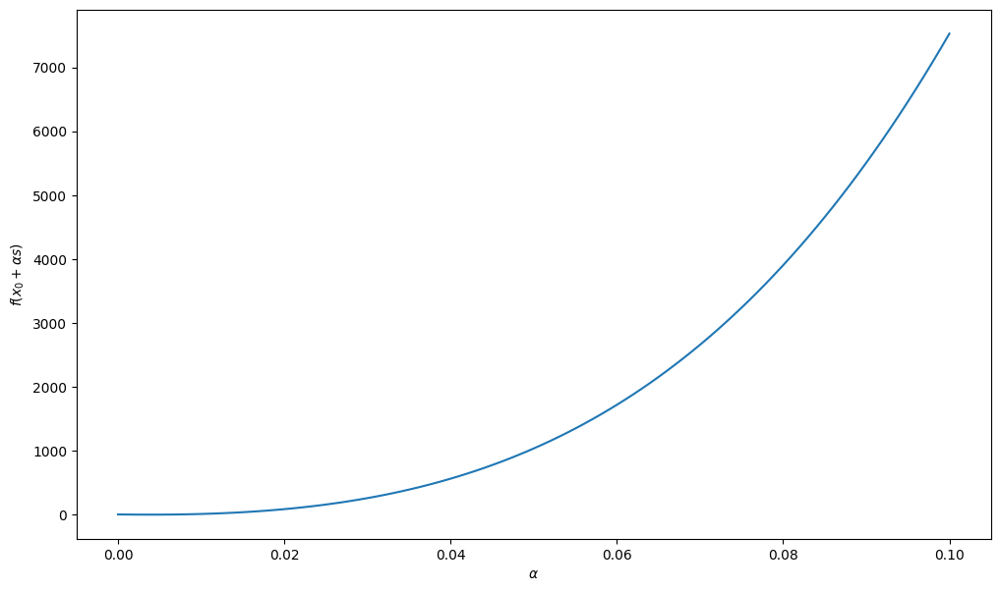

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

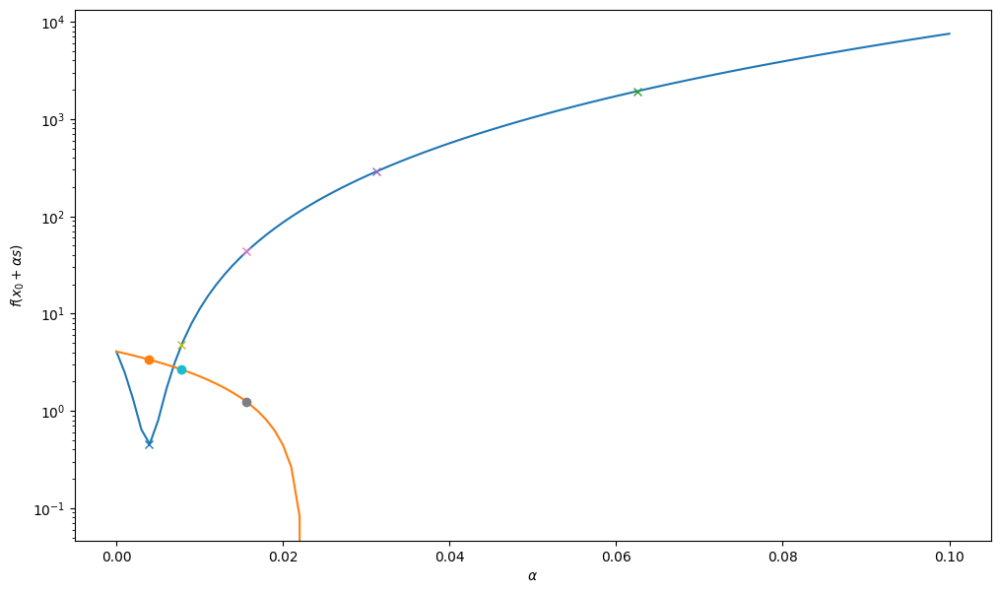

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

gen	nevals
0  	50    
1  	29    
2  	40    
3  	31    
4  	31    
5  	24    
6  	31    
7  	30    
8  	25    
9  	31    
10 	33    
11 	25    
12 	33    
13 	36    
14 	33    
15 	33    
16 	33    
17 	27    
18 	23    
19 	37    
20 	28    
21 	36    
22 	36    
23 	33    
24 	26    
25 	30    
26 	32    
27 	25    
28 	27    
29 	33    
30 	22    
31 	28    
32 	36    
33 	31    
34 	32    
35 	32    
36 	30    
37 	34    
38 	39    
39 	34    
40 	33    
41 	26    
42 	29    
43 	27    
44 	29    
45 	33    
46 	25    
47 	27    
48 	36    
49 	27    
50 	30    
51 	27    
52 	30    
53 	17    
54 	32    
55 	40    
56 	28    
57 	27    
58 	33    
59 	30    
60 	27    
61 	25    
62 	30    
63 	33    
64 	26    
65 	43    
66 	23    
67 	37    
68 	26    
69 	28    
70 	29    
71 	36    
72 	25    
73 	32    
74 	21    
75 	35    
76 	30    
77 	29    
78 	28    
79 	27    
80 	31    
81 	23    
82 	34    
83 	30    
84 	32    
85 	26    
86 	34    
87 	20    
88 	32    
89 	27    

##### Función Rosenbrock (Rosenbrock function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

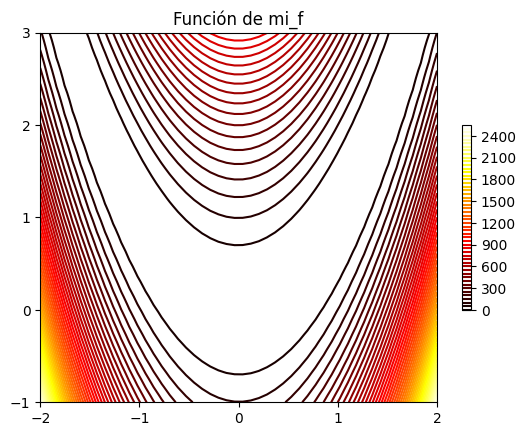

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

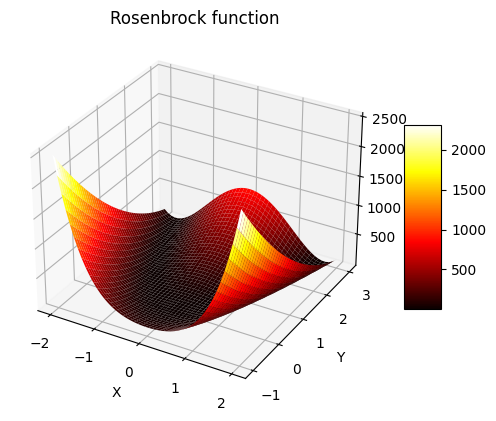

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

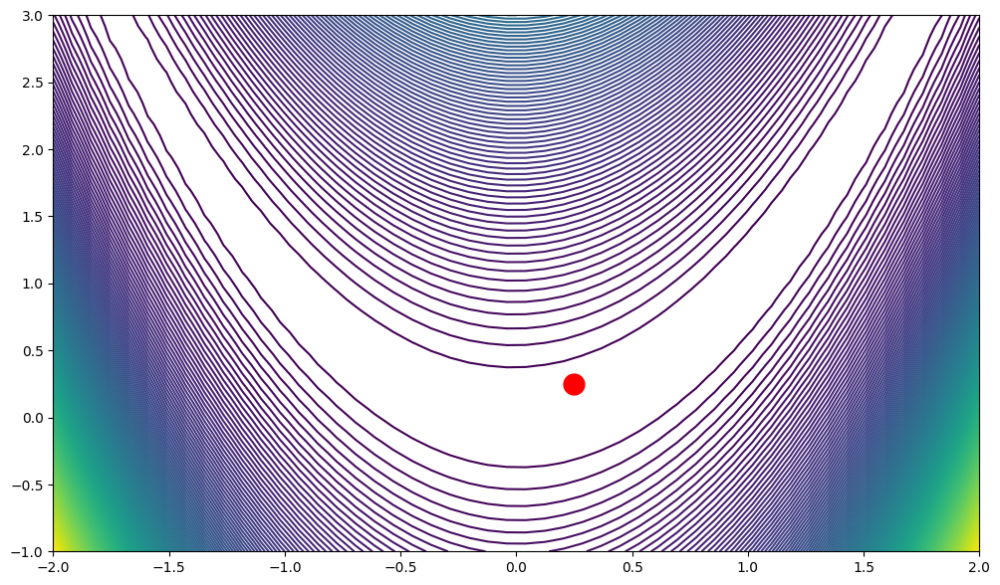

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-27-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-27-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

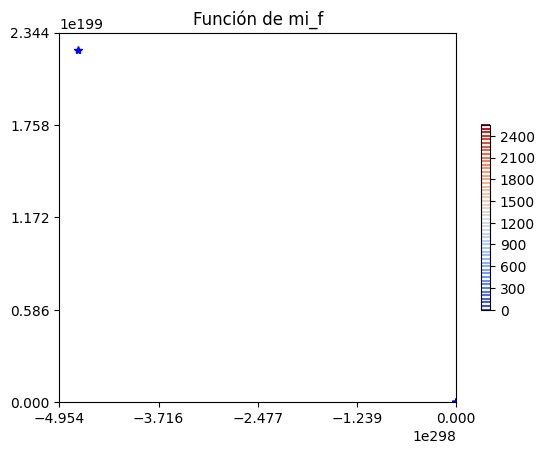

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


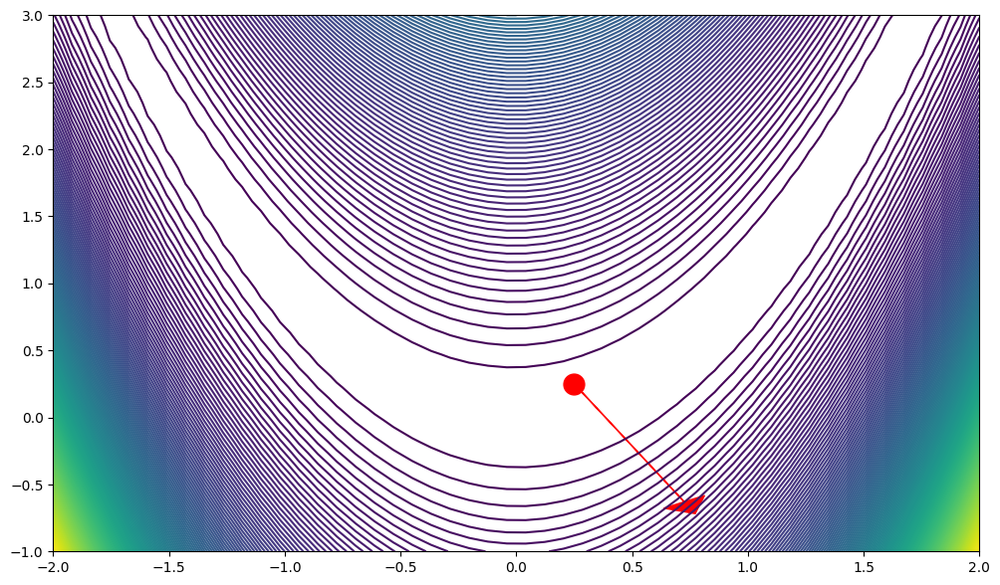

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


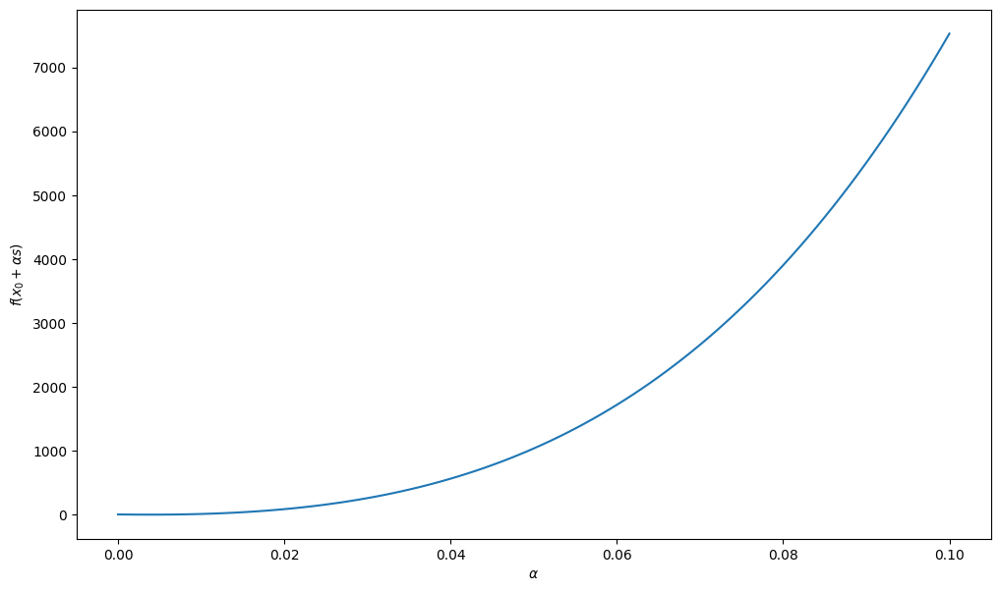

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

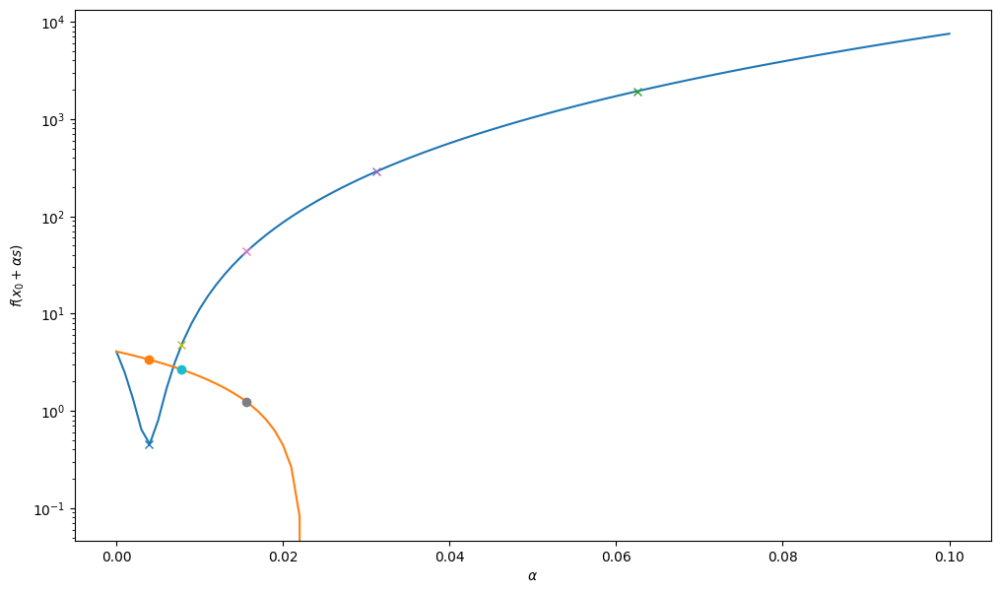

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


gen	nevals
0  	50    
1  	30    
2  	30    
3  	28    
4  	34    
5  	31    
6  	33    
7  	30    
8  	31    
9  	27    
10 	34    
11 	30    
12 	33    
13 	24    
14 	35    
15 	32    
16 	31    
17 	33    
18 	36    
19 	24    
20 	28    
21 	29    
22 	35    
23 	35    
24 	29    
25 	35    
26 	27    
27 	32    
28 	26    
29 	26    
30 	36    
31 	29    
32 	31    
33 	30    
34 	29    
35 	31    
36 	29    
37 	26    
38 	30    
39 	34    
40 	32    
41 	29    
42 	35    
43 	33    
44 	29    
45 	27    
46 	20    
47 	24    
48 	35    
49 	25    
50 	31    
51 	24    
52 	28    
53 	30    
54 	28    
55 	27    
56 	28    
57 	25    
58 	28    
59 	26    
60 	39    
61 	33    
62 	24    
63 	35    
64 	30    
65 	33    
66 	34    
67 	35    
68 	32    
69 	37    
70 	25    
71 	33    
72 	33    
73 	32    
74 	35    
75 	32    
76 	27    
77 	32    
78 	38    
79 	33    
80 	34    
81 	24    
82 	27    
83 	25    
84 	29    
85 	31    
86 	32    
87 	31    
88 	33    
89 	36    

##### Función Rastrigin (Rastrigin function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
A = 10
x = np.linspace(-5.12, 5.12, 100)
f = A + (x**2 - A * np.cos(2 * np.pi * x))

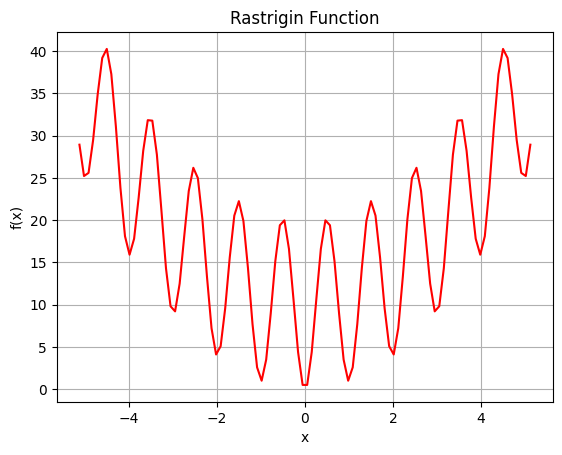

In [ ]:
plt.plot(x, f, 'r-')
plt.title('Rastrigin Function')
plt.xlabel('x')
plt.ylabel('f(x)')
plt.grid()
plt.show()

In [ ]:
def f(x):
  A = 10
  y = A + (x**2 - A * np.cos(2 * np.pi * x))
  return(y)

def df(x):
  A = 10
  y = 2*x + 2*np.pi*A*np.sin(2*np.pi*x)
  return(y)

In [ ]:
def mi_optimizador(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k])
  return(solucion,valor_obj,k)


In [ ]:
sol, f_obj, k = mi_optimizador(x0 = 0.25, g=f, g1p=df, lr = 0.1, tol = 0.0001)

In [ ]:
# Gráfica de la solución
plt.plot(x,y, 'r-',label = 'funcion')
plt.plot(sol,f_obj,'b*', label = 'solucion')
plt.title('Grafíca de $x^2 \cos(x)$')
plt.xlabel('$x$')
plt.legend()
plt.grid()
plt.show()

\#### Función Rosenbrock (Rosenbrock function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

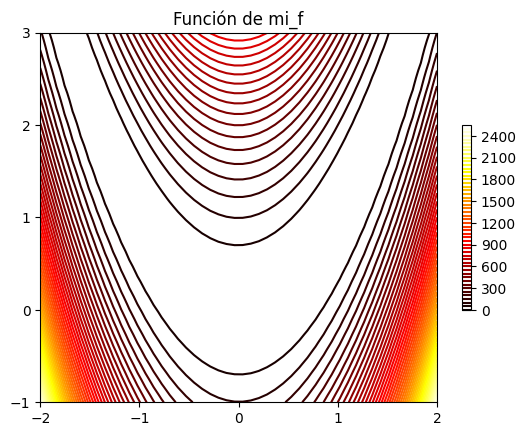

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

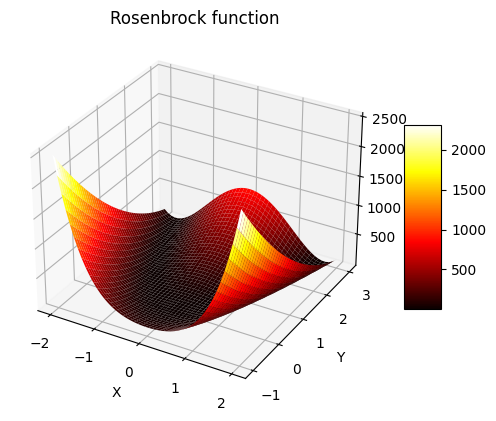

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

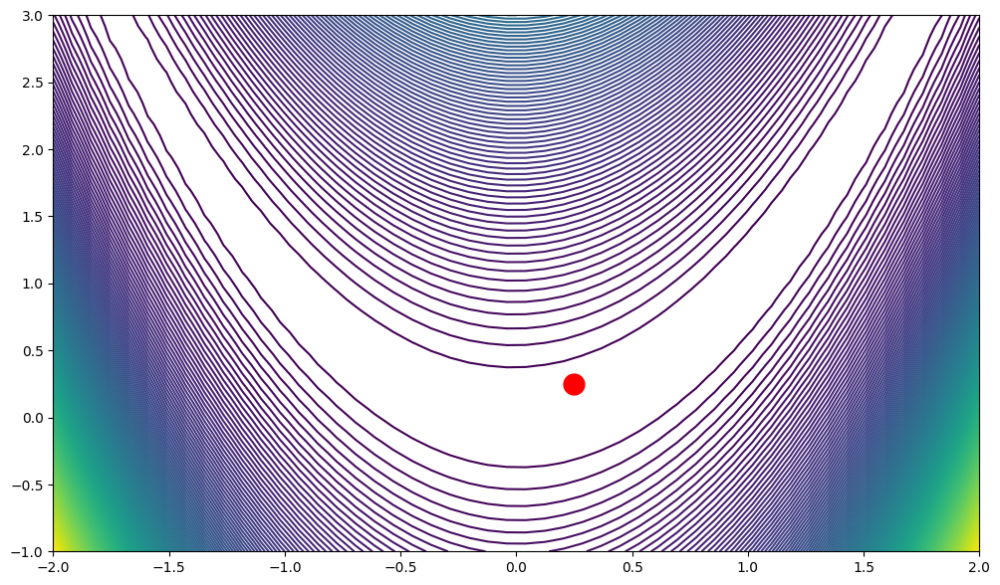

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-7-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-7-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

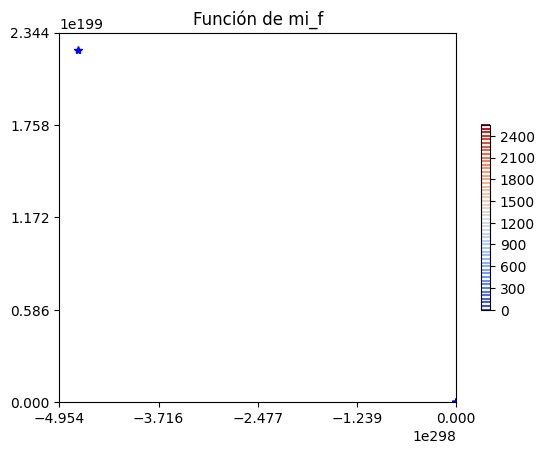

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


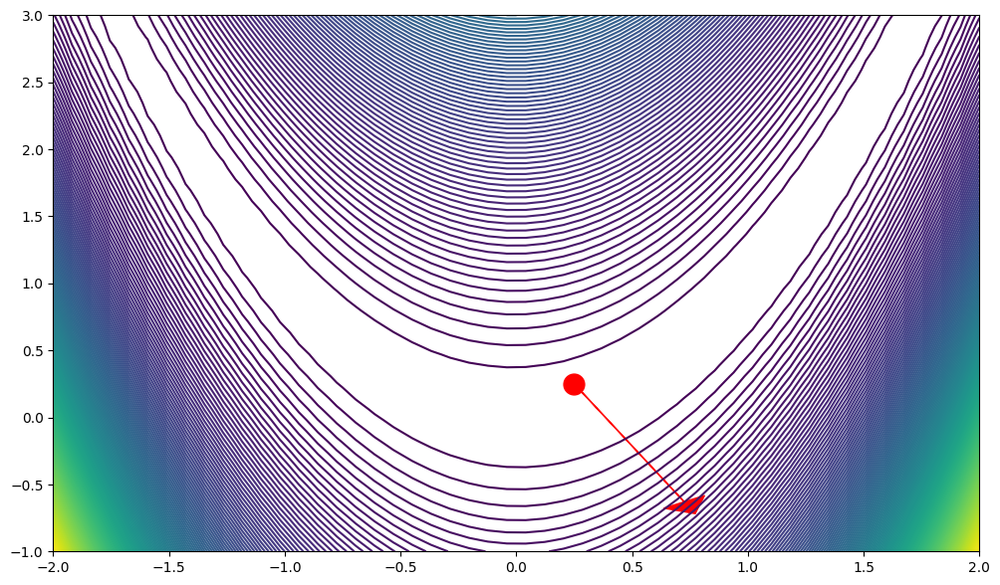

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


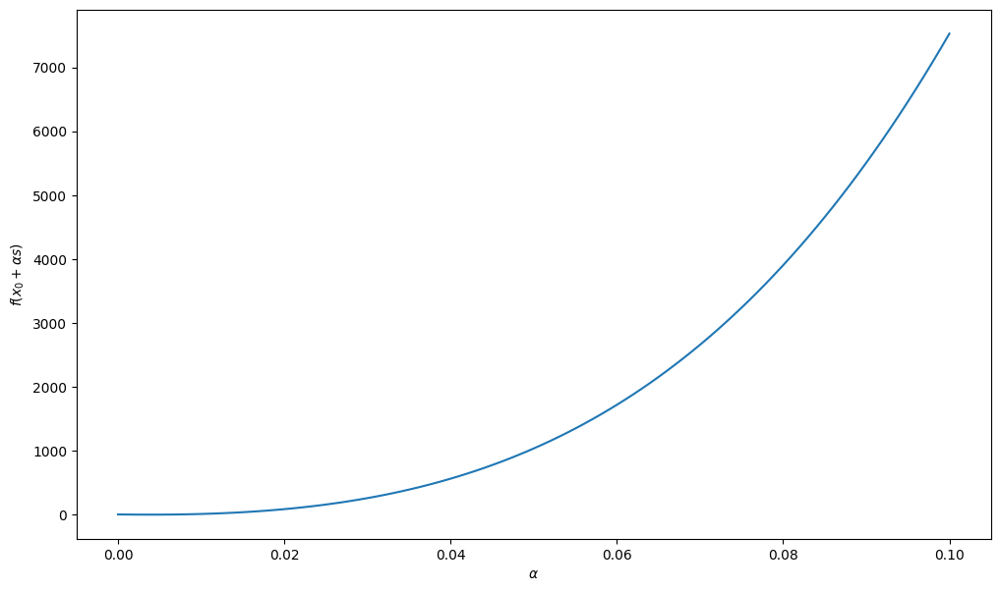

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

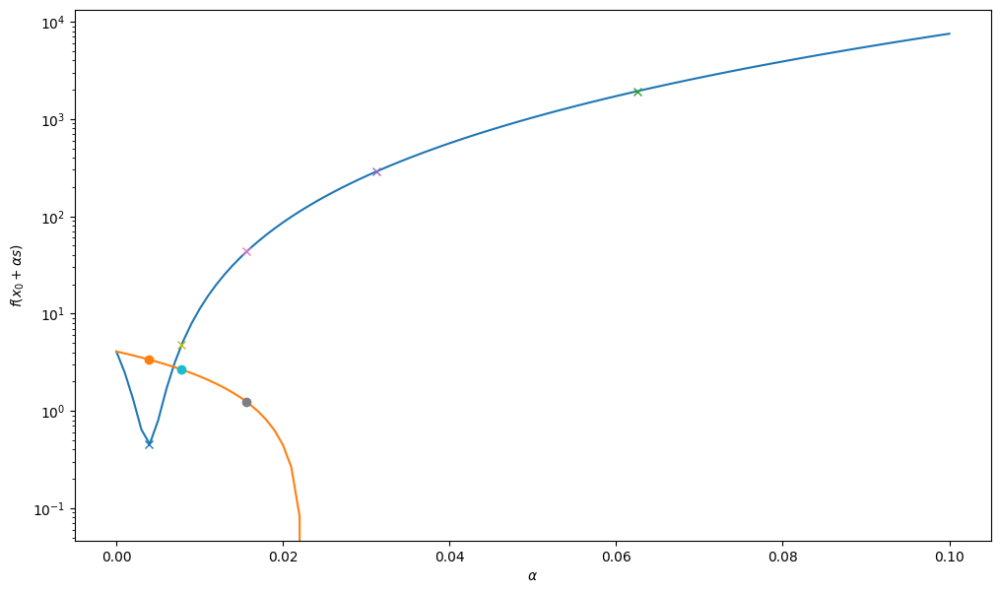

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

gen	nevals
0  	50    
1  	29    
2  	40    
3  	31    
4  	31    
5  	24    
6  	31    
7  	30    
8  	25    
9  	31    
10 	33    
11 	25    
12 	33    
13 	36    
14 	33    
15 	33    
16 	33    
17 	27    
18 	23    
19 	37    
20 	28    
21 	36    
22 	36    
23 	33    
24 	26    
25 	30    
26 	32    
27 	25    
28 	27    
29 	33    
30 	22    
31 	28    
32 	36    
33 	31    
34 	32    
35 	32    
36 	30    
37 	34    
38 	39    
39 	34    
40 	33    
41 	26    
42 	29    
43 	27    
44 	29    
45 	33    
46 	25    
47 	27    
48 	36    
49 	27    
50 	30    
51 	27    
52 	30    
53 	17    
54 	32    
55 	40    
56 	28    
57 	27    
58 	33    
59 	30    
60 	27    
61 	25    
62 	30    
63 	33    
64 	26    
65 	43    
66 	23    
67 	37    
68 	26    
69 	28    
70 	29    
71 	36    
72 	25    
73 	32    
74 	21    
75 	35    
76 	30    
77 	29    
78 	28    
79 	27    
80 	31    
81 	23    
82 	34    
83 	30    
84 	32    
85 	26    
86 	34    
87 	20    
88 	32    
89 	27    

### 3. Optimice las funciones en dos y tres dimensiones usando: Algoritmos evolutivos, optimización de partículas y evolución diferencial.

#### Optimización de funciones de prueba - Método de algoritmos evolutivos.

##### Función Rosenbrock (Rosenbrock function) - 2 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

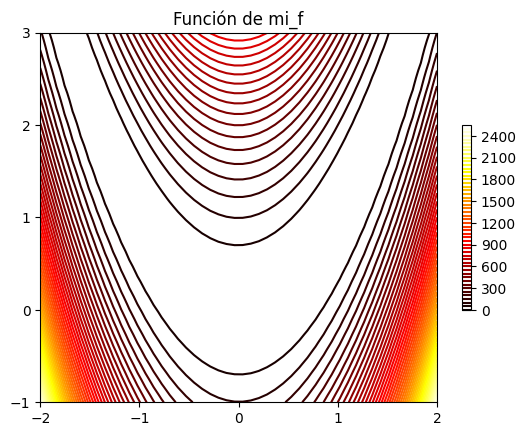

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

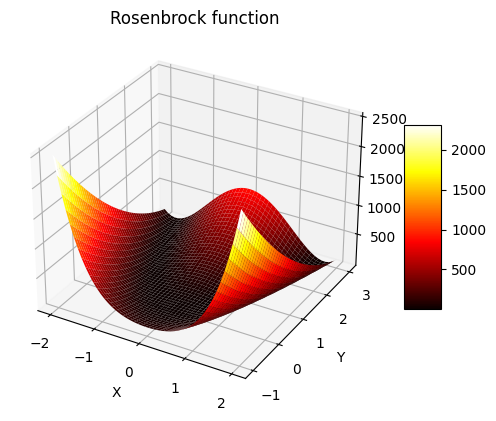

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

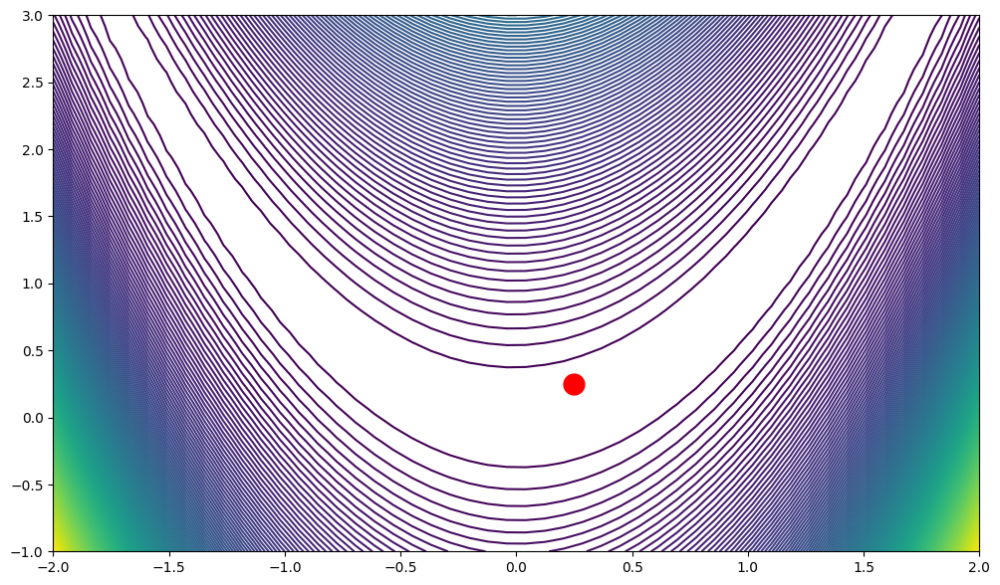

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-7-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-7-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

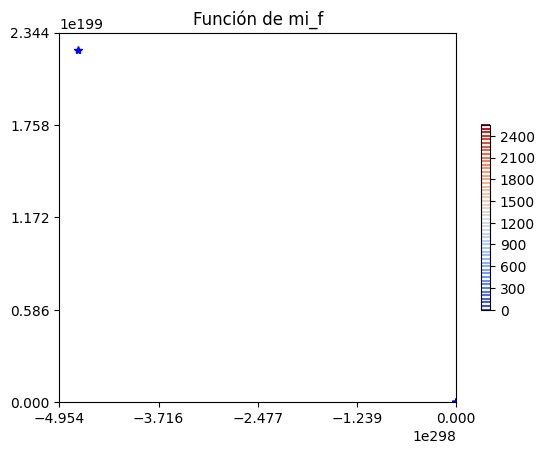

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


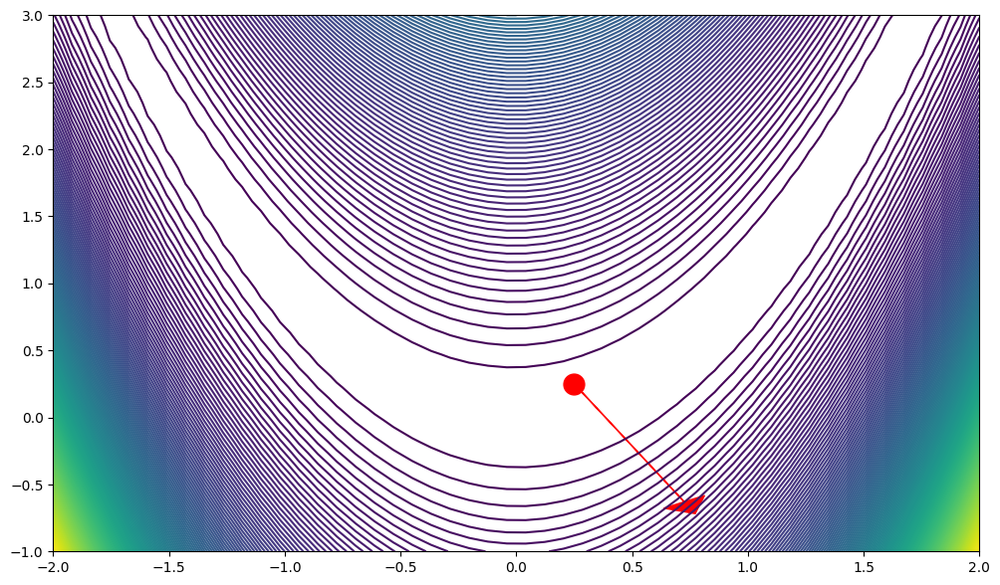

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


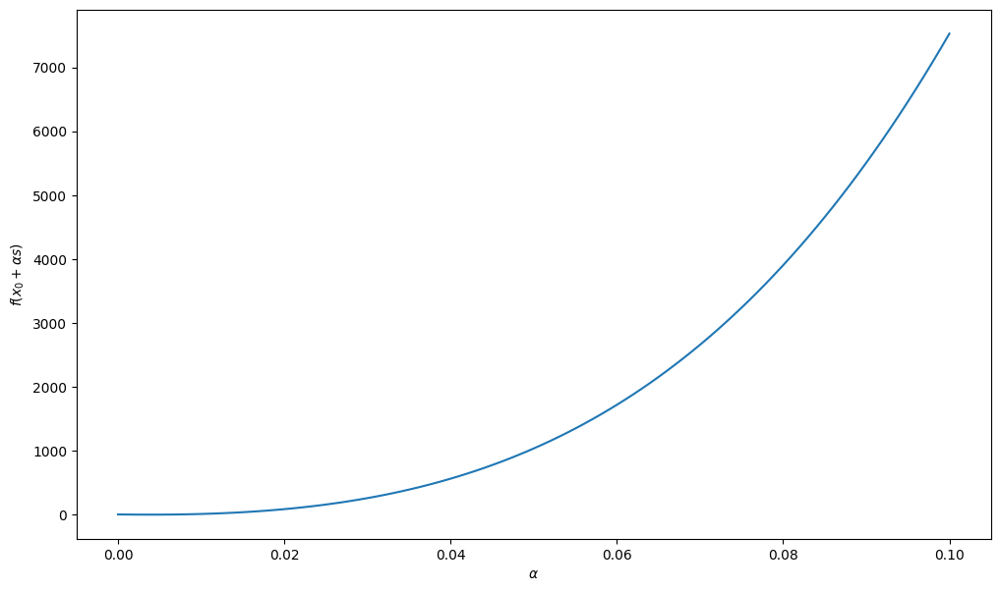

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

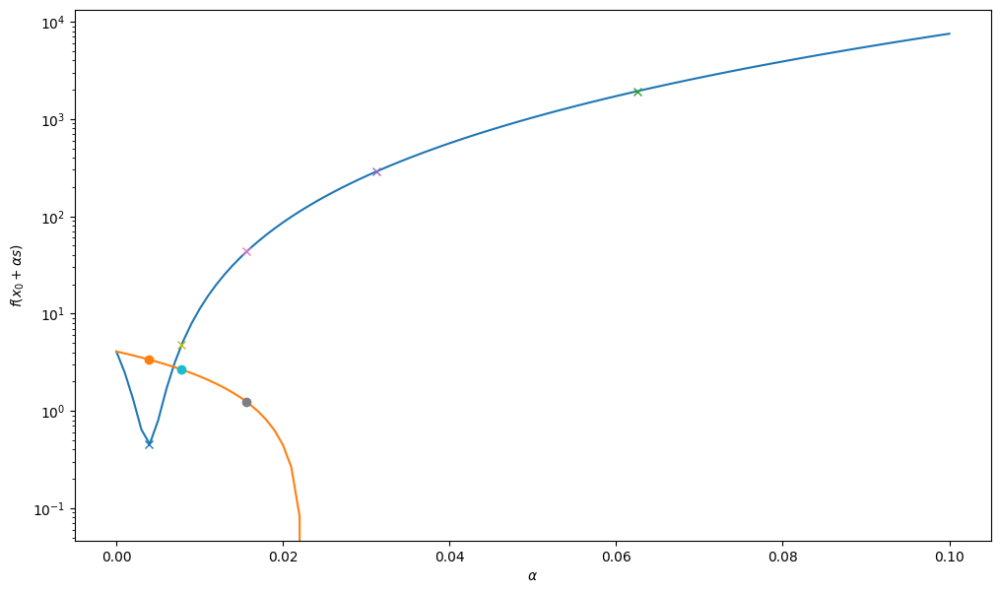

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

gen	nevals
0  	50    
1  	29    
2  	40    
3  	31    
4  	31    
5  	24    
6  	31    
7  	30    
8  	25    
9  	31    
10 	33    
11 	25    
12 	33    
13 	36    
14 	33    
15 	33    
16 	33    
17 	27    
18 	23    
19 	37    
20 	28    
21 	36    
22 	36    
23 	33    
24 	26    
25 	30    
26 	32    
27 	25    
28 	27    
29 	33    
30 	22    
31 	28    
32 	36    
33 	31    
34 	32    
35 	32    
36 	30    
37 	34    
38 	39    
39 	34    
40 	33    
41 	26    
42 	29    
43 	27    
44 	29    
45 	33    
46 	25    
47 	27    
48 	36    
49 	27    
50 	30    
51 	27    
52 	30    
53 	17    
54 	32    
55 	40    
56 	28    
57 	27    
58 	33    
59 	30    
60 	27    
61 	25    
62 	30    
63 	33    
64 	26    
65 	43    
66 	23    
67 	37    
68 	26    
69 	28    
70 	29    
71 	36    
72 	25    
73 	32    
74 	21    
75 	35    
76 	30    
77 	29    
78 	28    
79 	27    
80 	31    
81 	23    
82 	34    
83 	30    
84 	32    
85 	26    
86 	34    
87 	20    
88 	32    
89 	27    

##### Función Rastrigin (Rastrigin function) - 2 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
A = 10
x = np.linspace(-5.12, 5.12, 100)
f = A + (x**2 - A * np.cos(2 * np.pi * x))

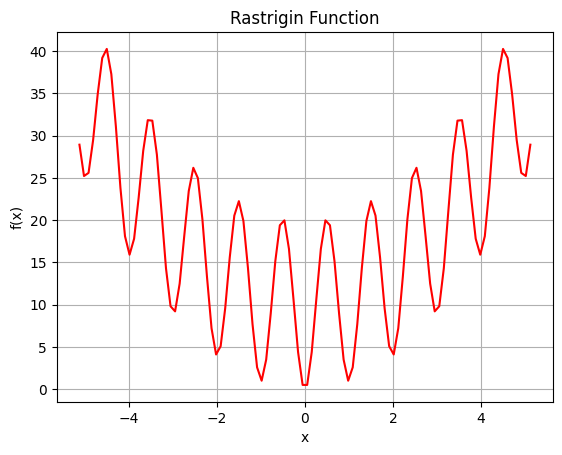

In [ ]:
plt.plot(x, f, 'r-')
plt.title('Rastrigin Function')
plt.xlabel('x')
plt.ylabel('f(x)')
plt.grid()
plt.show()

In [ ]:
def f(x):
  A = 10
  y = A + (x**2 - A * np.cos(2 * np.pi * x))
  return(y)

def df(x):
  A = 10
  y = 2*x + 2*np.pi*A*np.sin(2*np.pi*x)
  return(y)

In [ ]:
def mi_optimizador(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k])
  return(solucion,valor_obj,k)


In [ ]:
sol, f_obj, k = mi_optimizador(x0 = 0.25, g=f, g1p=df, lr = 0.1, tol = 0.0001)

In [ ]:
# Gráfica de la solución
plt.plot(x,y, 'r-',label = 'funcion')
plt.plot(sol,f_obj,'b*', label = 'solucion')
plt.title('Grafíca de $x^2 \cos(x)$')
plt.xlabel('$x$')
plt.legend()
plt.grid()
plt.show()

\#### Función Rosenbrock (Rosenbrock function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

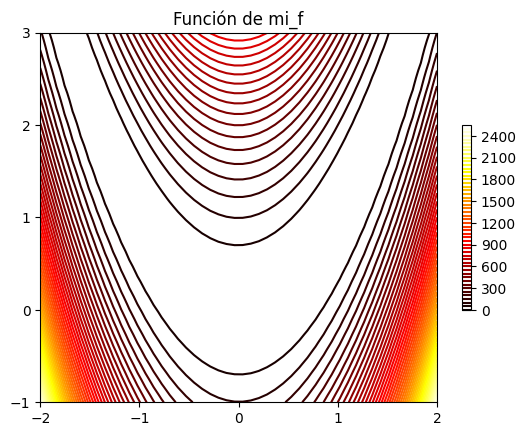

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

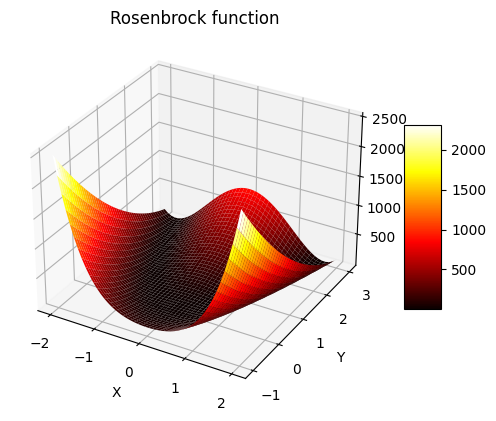

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

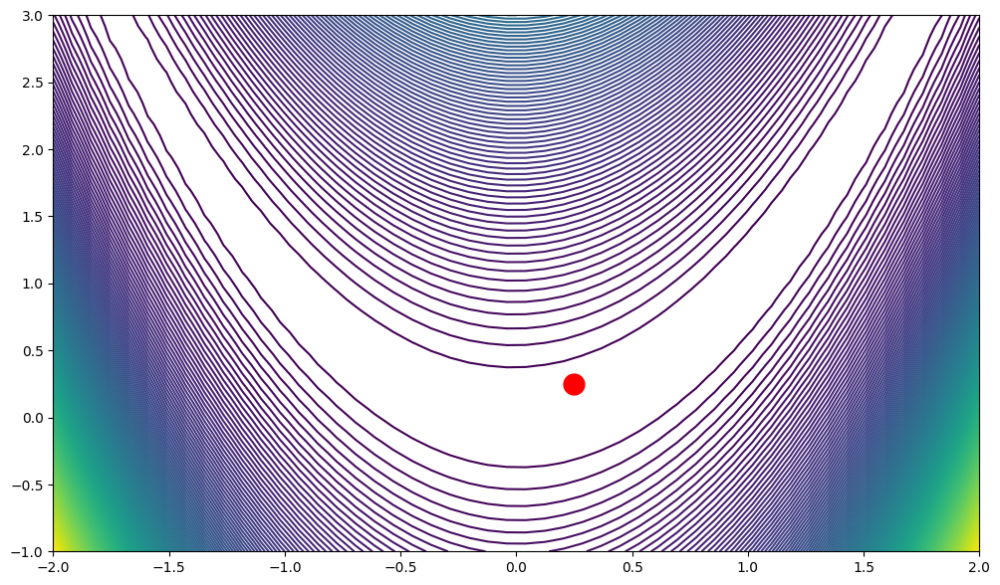

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-7-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-7-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

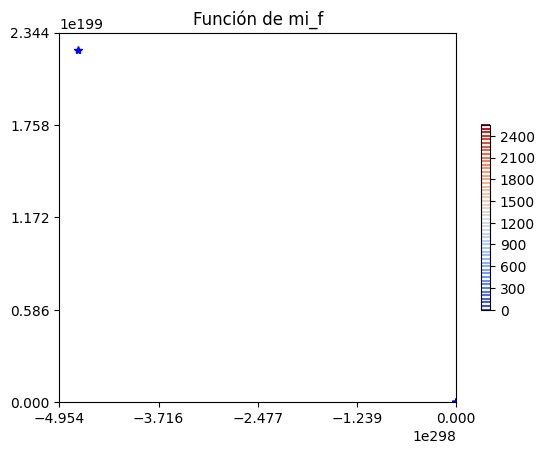

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


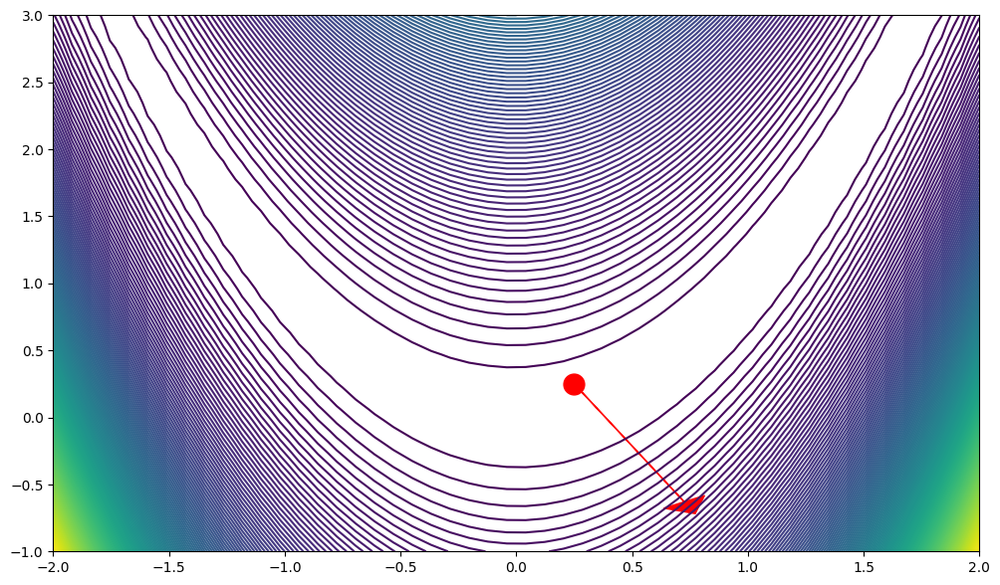

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


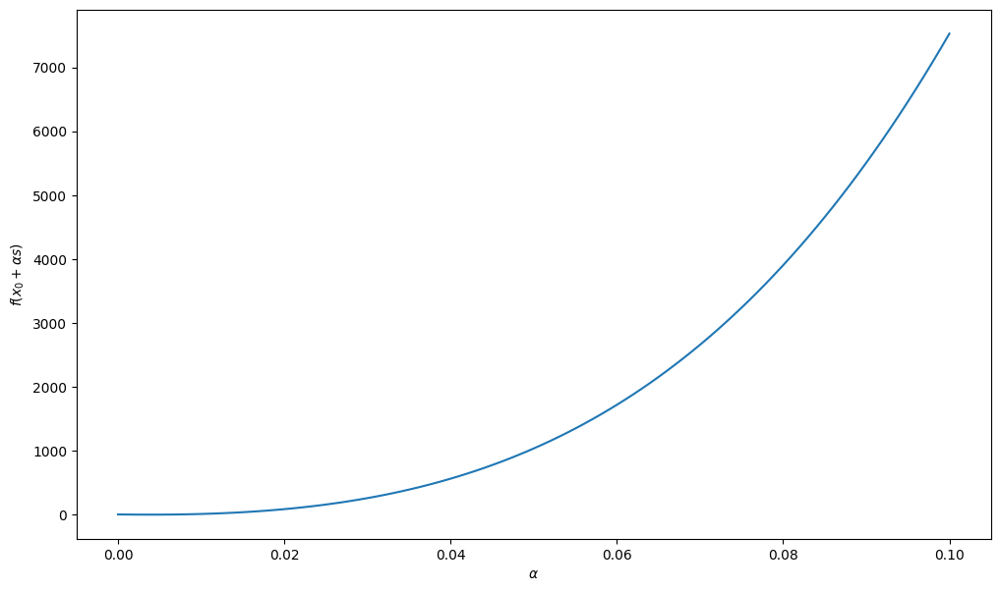

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

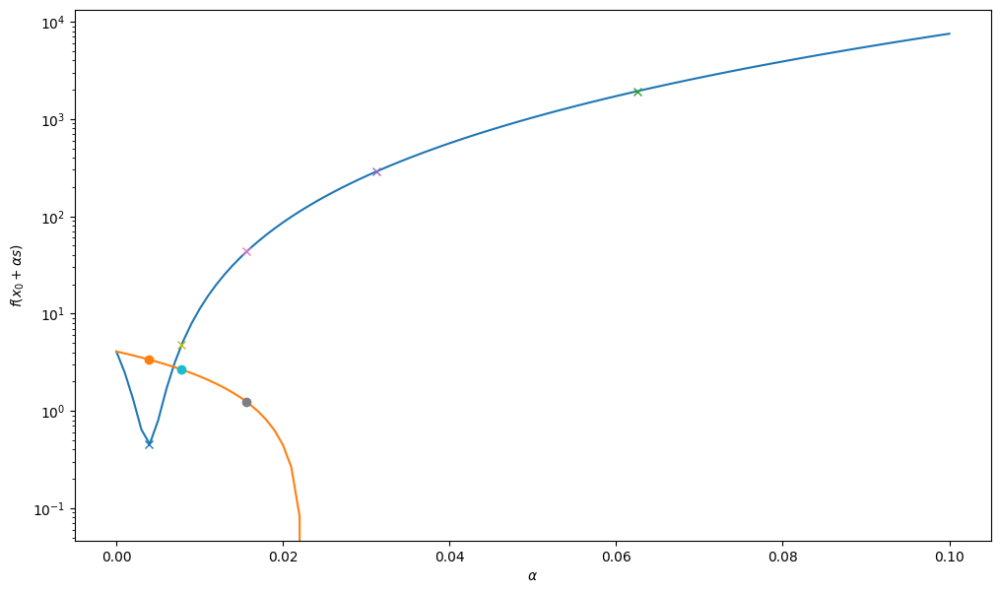

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

gen	nevals
0  	50    
1  	29    
2  	40    
3  	31    
4  	31    
5  	24    
6  	31    
7  	30    
8  	25    
9  	31    
10 	33    
11 	25    
12 	33    
13 	36    
14 	33    
15 	33    
16 	33    
17 	27    
18 	23    
19 	37    
20 	28    
21 	36    
22 	36    
23 	33    
24 	26    
25 	30    
26 	32    
27 	25    
28 	27    
29 	33    
30 	22    
31 	28    
32 	36    
33 	31    
34 	32    
35 	32    
36 	30    
37 	34    
38 	39    
39 	34    
40 	33    
41 	26    
42 	29    
43 	27    
44 	29    
45 	33    
46 	25    
47 	27    
48 	36    
49 	27    
50 	30    
51 	27    
52 	30    
53 	17    
54 	32    
55 	40    
56 	28    
57 	27    
58 	33    
59 	30    
60 	27    
61 	25    
62 	30    
63 	33    
64 	26    
65 	43    
66 	23    
67 	37    
68 	26    
69 	28    
70 	29    
71 	36    
72 	25    
73 	32    
74 	21    
75 	35    
76 	30    
77 	29    
78 	28    
79 	27    
80 	31    
81 	23    
82 	34    
83 	30    
84 	32    
85 	26    
86 	34    
87 	20    
88 	32    
89 	27    

##### Función Rosenbrock (Rosenbrock function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

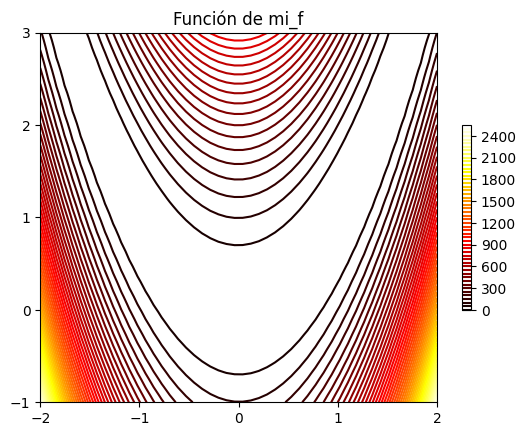

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

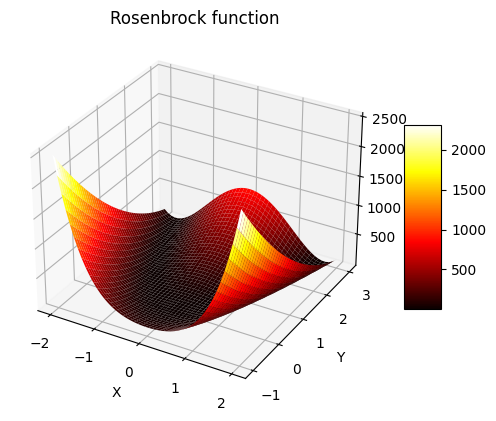

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

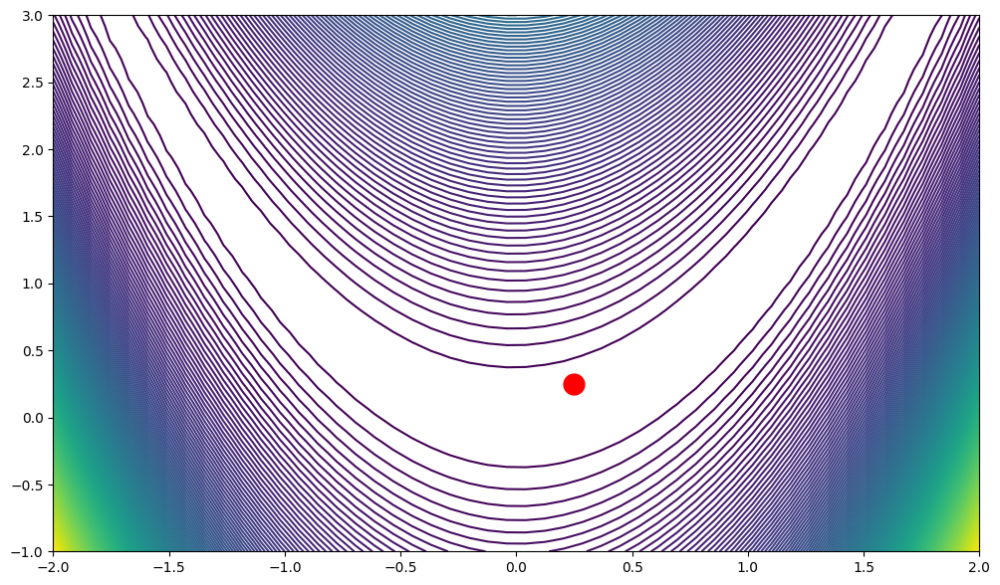

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-7-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-7-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

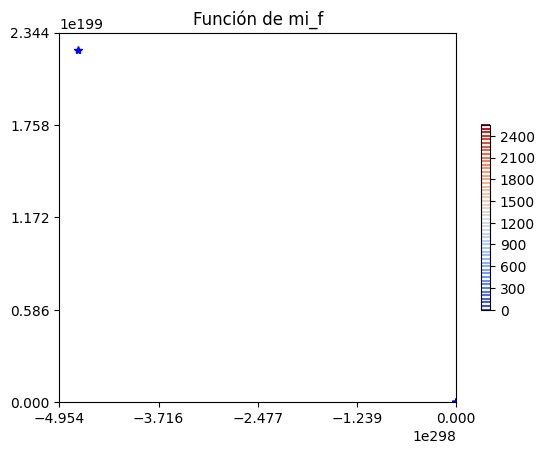

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


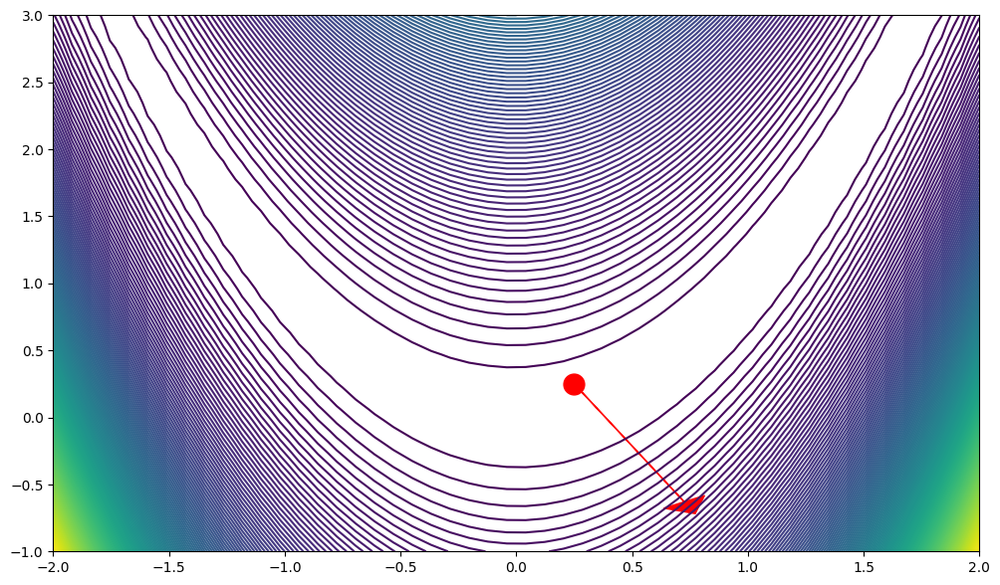

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


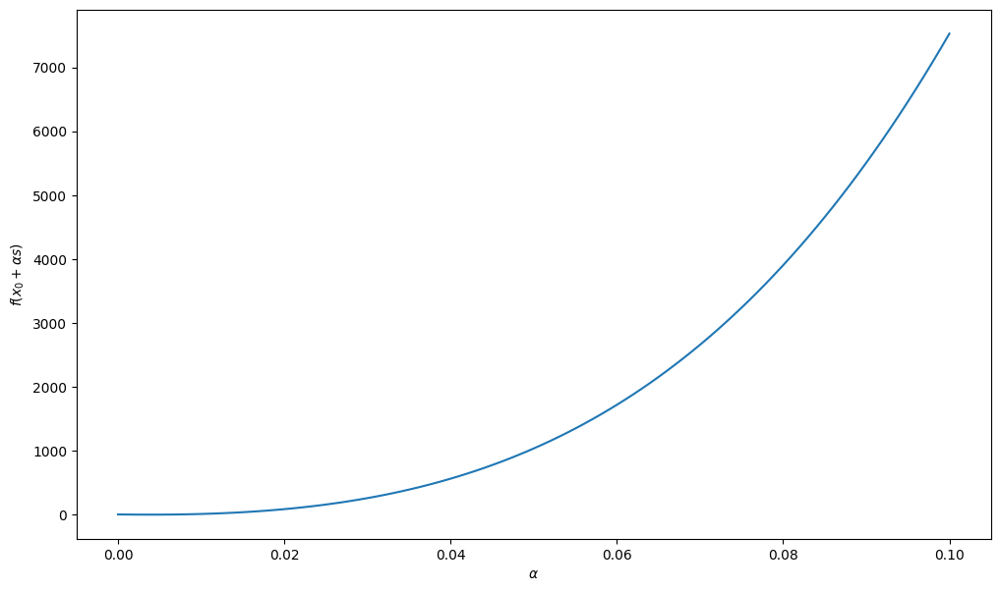

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

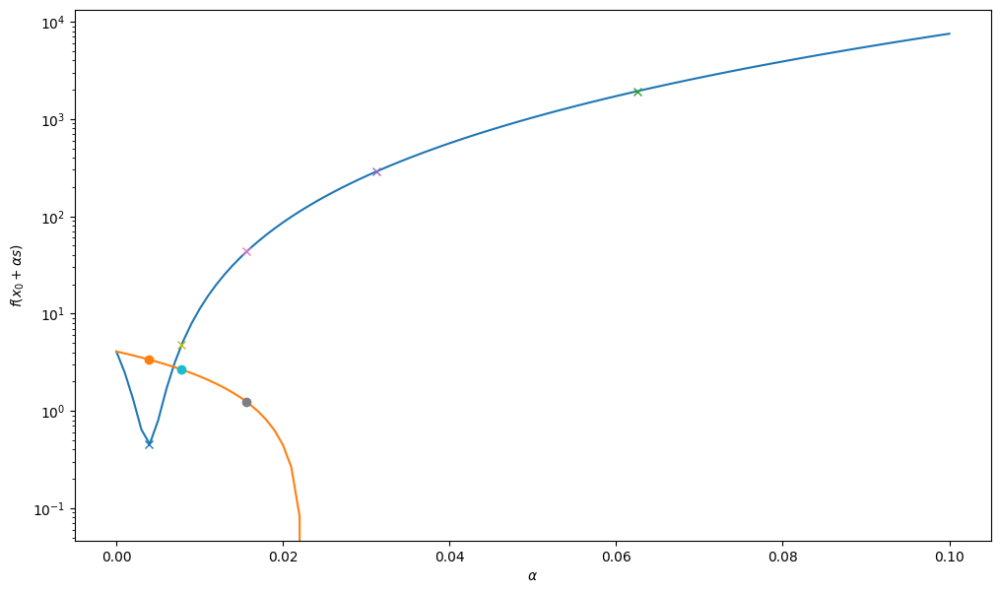

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

gen	nevals
0  	50    
1  	29    
2  	40    
3  	31    
4  	31    
5  	24    
6  	31    
7  	30    
8  	25    
9  	31    
10 	33    
11 	25    
12 	33    
13 	36    
14 	33    
15 	33    
16 	33    
17 	27    
18 	23    
19 	37    
20 	28    
21 	36    
22 	36    
23 	33    
24 	26    
25 	30    
26 	32    
27 	25    
28 	27    
29 	33    
30 	22    
31 	28    
32 	36    
33 	31    
34 	32    
35 	32    
36 	30    
37 	34    
38 	39    
39 	34    
40 	33    
41 	26    
42 	29    
43 	27    
44 	29    
45 	33    
46 	25    
47 	27    
48 	36    
49 	27    
50 	30    
51 	27    
52 	30    
53 	17    
54 	32    
55 	40    
56 	28    
57 	27    
58 	33    
59 	30    
60 	27    
61 	25    
62 	30    
63 	33    
64 	26    
65 	43    
66 	23    
67 	37    
68 	26    
69 	28    
70 	29    
71 	36    
72 	25    
73 	32    
74 	21    
75 	35    
76 	30    
77 	29    
78 	28    
79 	27    
80 	31    
81 	23    
82 	34    
83 	30    
84 	32    
85 	26    
86 	34    
87 	20    
88 	32    
89 	27    

##### Función Rastrigin (Rastrigin function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
A = 10
x = np.linspace(-5.12, 5.12, 100)
f = A + (x**2 - A * np.cos(2 * np.pi * x))

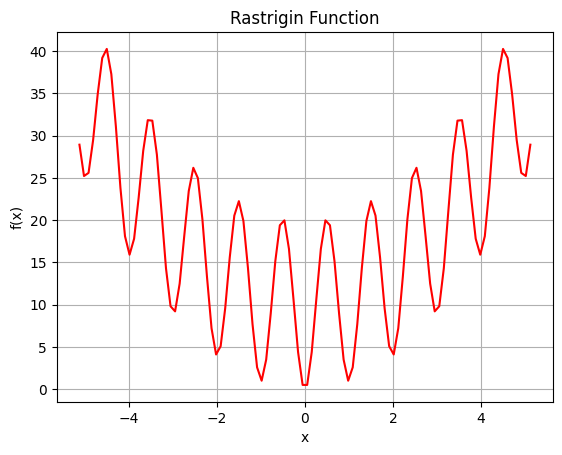

In [ ]:
plt.plot(x, f, 'r-')
plt.title('Rastrigin Function')
plt.xlabel('x')
plt.ylabel('f(x)')
plt.grid()
plt.show()

In [ ]:
def f(x):
  A = 10
  y = A + (x**2 - A * np.cos(2 * np.pi * x))
  return(y)

def df(x):
  A = 10
  y = 2*x + 2*np.pi*A*np.sin(2*np.pi*x)
  return(y)

In [ ]:
def mi_optimizador(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k])
  return(solucion,valor_obj,k)


In [ ]:
sol, f_obj, k = mi_optimizador(x0 = 0.25, g=f, g1p=df, lr = 0.1, tol = 0.0001)

In [ ]:
# Gráfica de la solución
plt.plot(x,y, 'r-',label = 'funcion')
plt.plot(sol,f_obj,'b*', label = 'solucion')
plt.title('Grafíca de $x^2 \cos(x)$')
plt.xlabel('$x$')
plt.legend()
plt.grid()
plt.show()

\#### Función Rosenbrock (Rosenbrock function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

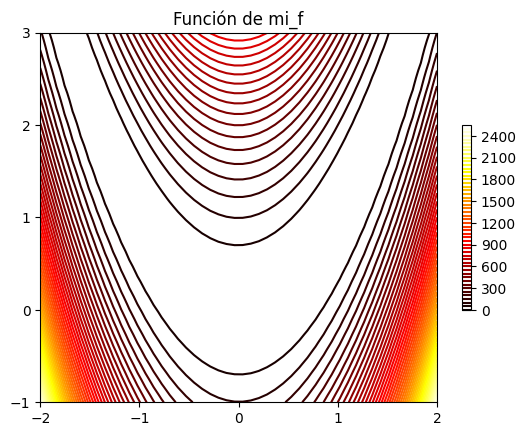

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

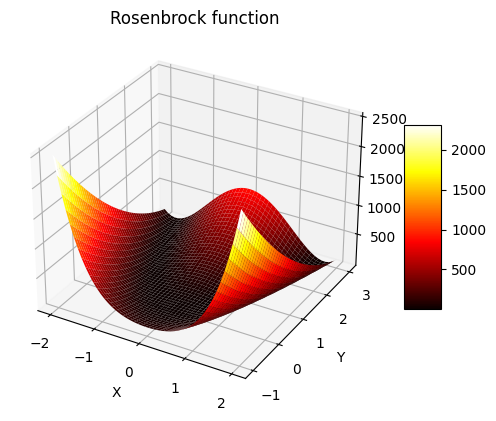

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

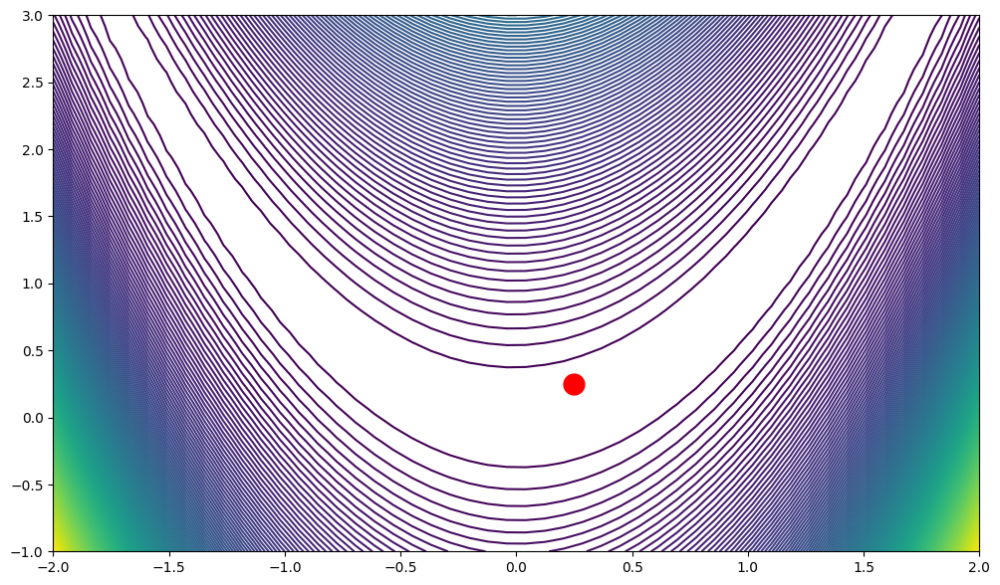

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-7-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-7-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

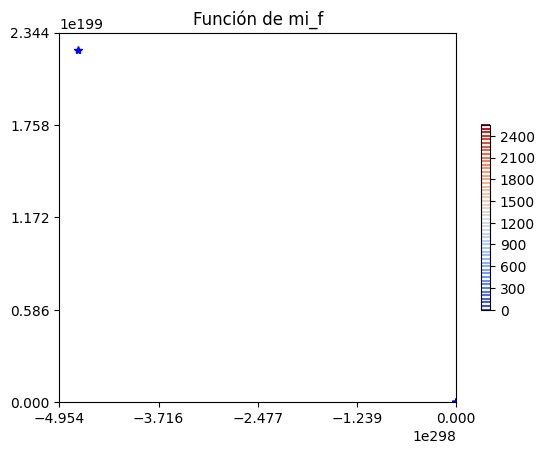

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


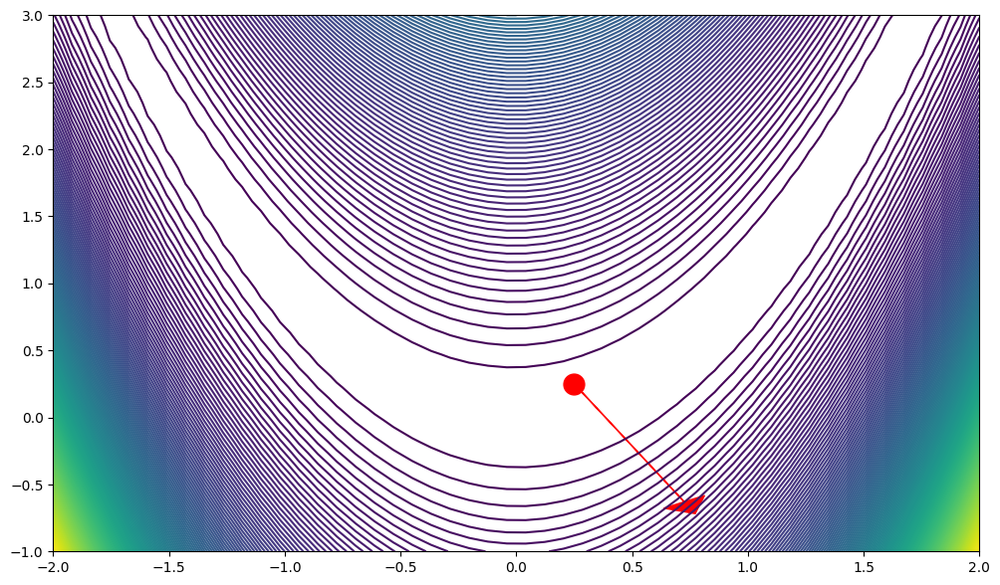

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


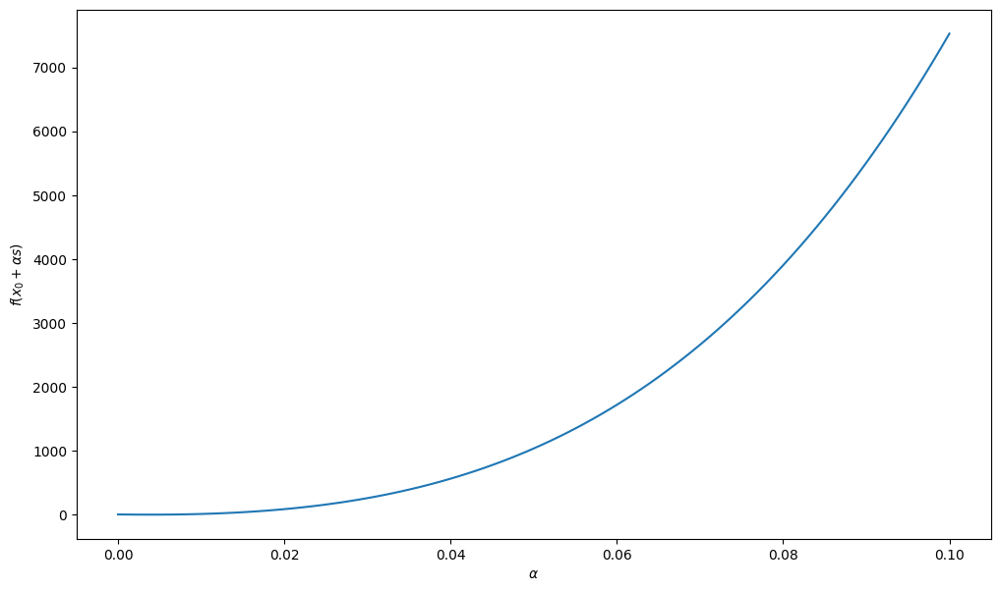

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

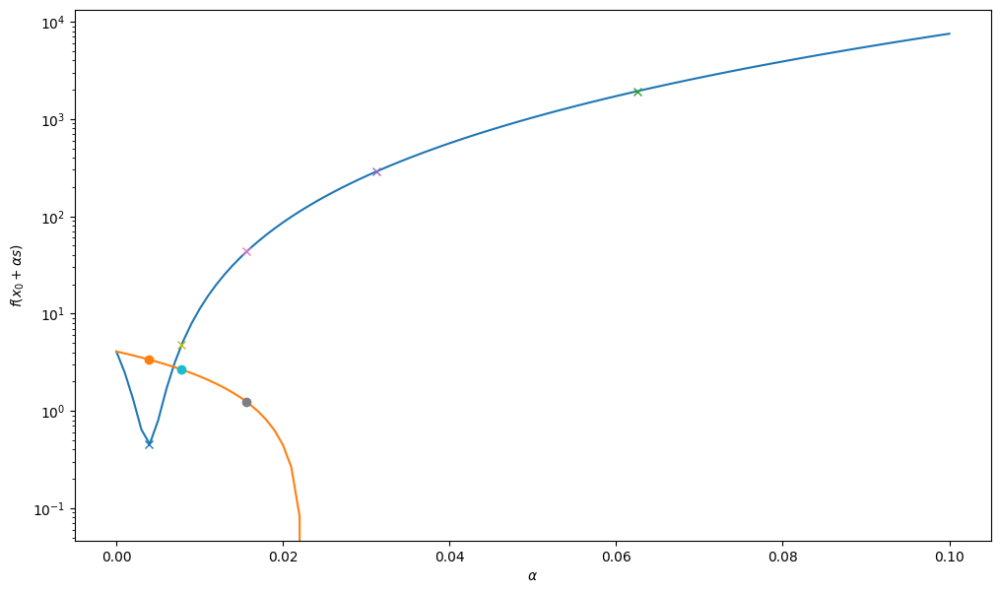

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

gen	nevals
0  	50    
1  	29    
2  	40    
3  	31    
4  	31    
5  	24    
6  	31    
7  	30    
8  	25    
9  	31    
10 	33    
11 	25    
12 	33    
13 	36    
14 	33    
15 	33    
16 	33    
17 	27    
18 	23    
19 	37    
20 	28    
21 	36    
22 	36    
23 	33    
24 	26    
25 	30    
26 	32    
27 	25    
28 	27    
29 	33    
30 	22    
31 	28    
32 	36    
33 	31    
34 	32    
35 	32    
36 	30    
37 	34    
38 	39    
39 	34    
40 	33    
41 	26    
42 	29    
43 	27    
44 	29    
45 	33    
46 	25    
47 	27    
48 	36    
49 	27    
50 	30    
51 	27    
52 	30    
53 	17    
54 	32    
55 	40    
56 	28    
57 	27    
58 	33    
59 	30    
60 	27    
61 	25    
62 	30    
63 	33    
64 	26    
65 	43    
66 	23    
67 	37    
68 	26    
69 	28    
70 	29    
71 	36    
72 	25    
73 	32    
74 	21    
75 	35    
76 	30    
77 	29    
78 	28    
79 	27    
80 	31    
81 	23    
82 	34    
83 	30    
84 	32    
85 	26    
86 	34    
87 	20    
88 	32    
89 	27    

#### Optimización de funciones de prueba - Método de optimización de partículas.

##### Función Rosenbrock (Rosenbrock function) - 2 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

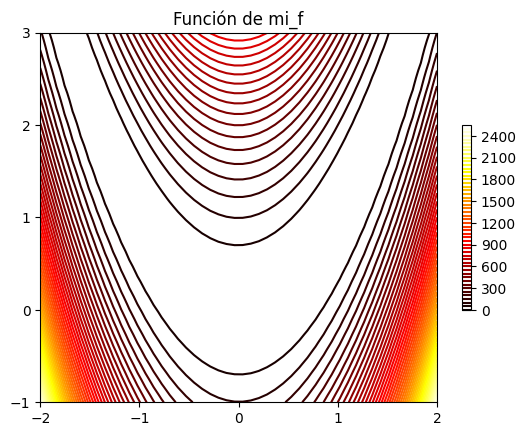

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

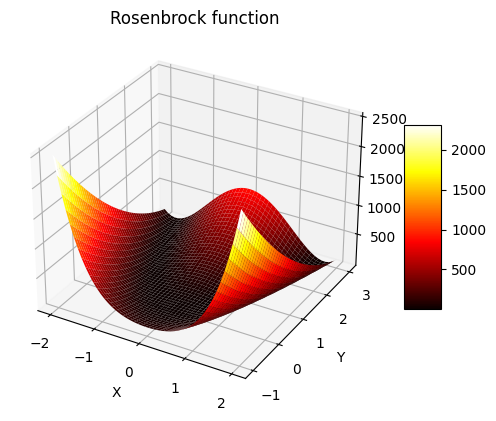

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

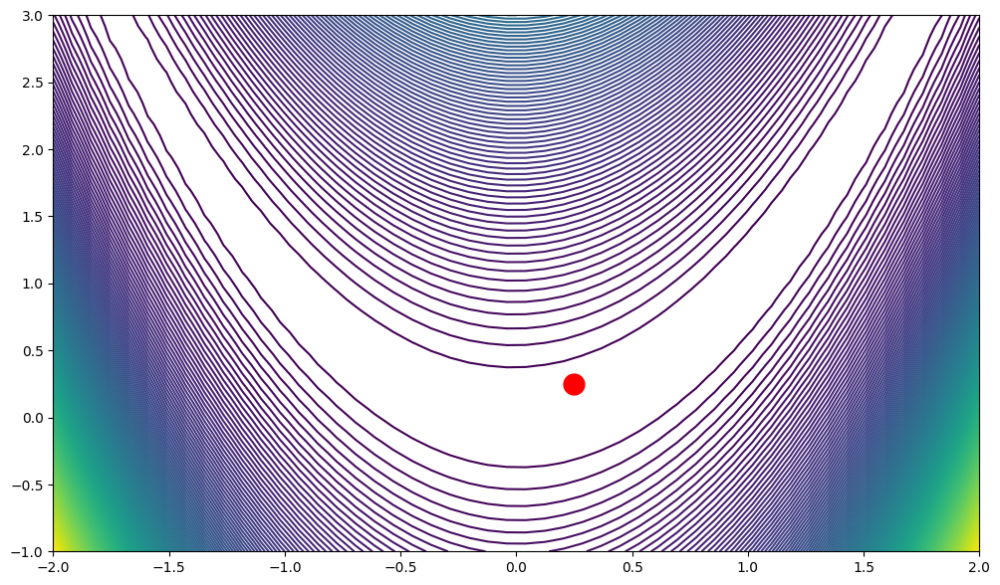

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-7-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-7-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

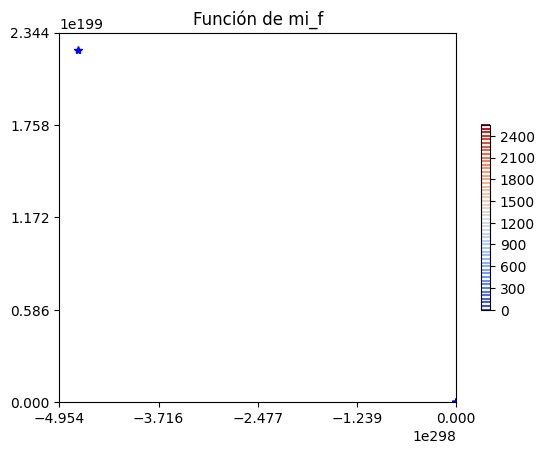

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


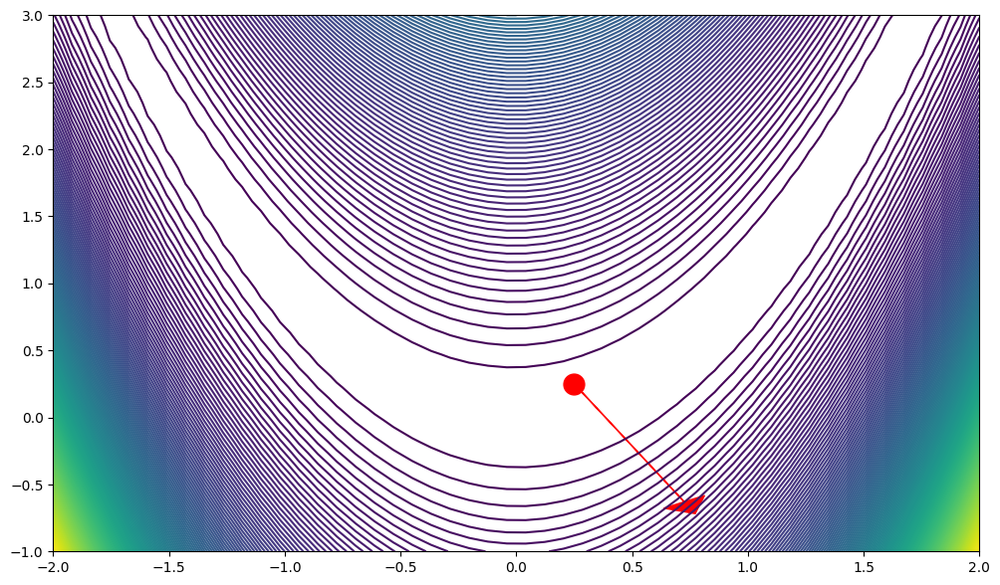

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


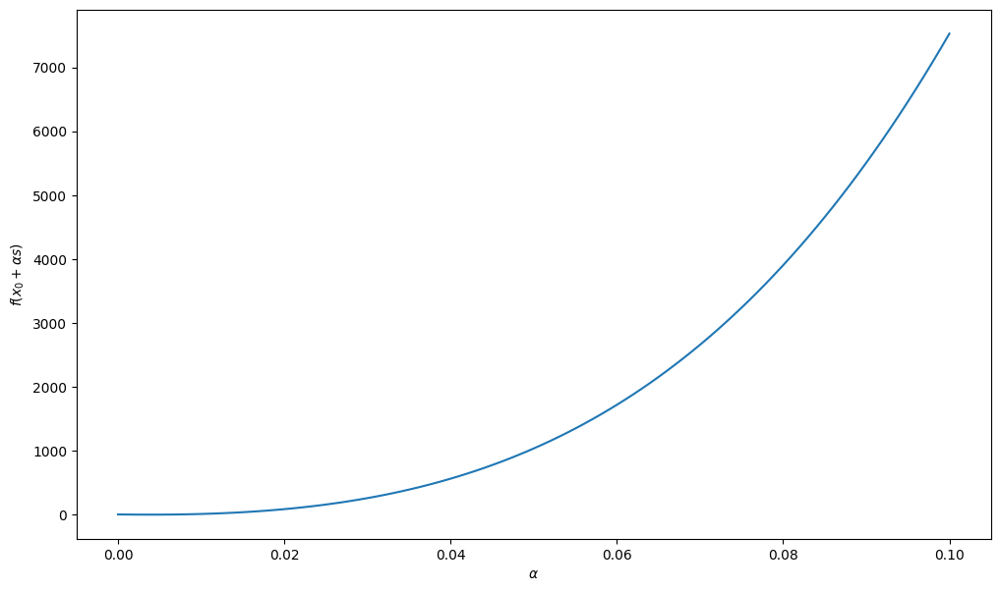

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

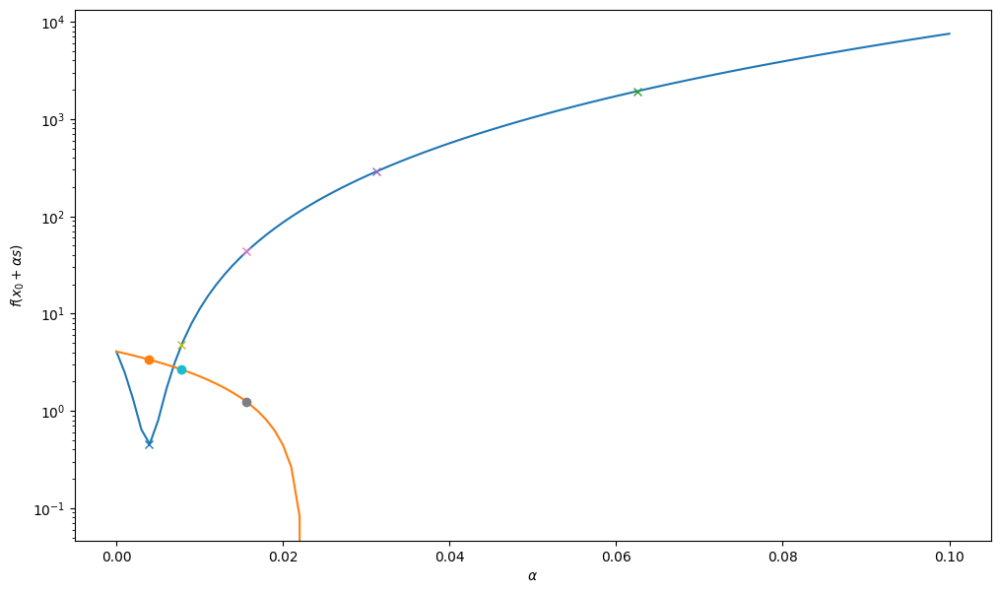

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

gen	nevals
0  	50    
1  	29    
2  	40    
3  	31    
4  	31    
5  	24    
6  	31    
7  	30    
8  	25    
9  	31    
10 	33    
11 	25    
12 	33    
13 	36    
14 	33    
15 	33    
16 	33    
17 	27    
18 	23    
19 	37    
20 	28    
21 	36    
22 	36    
23 	33    
24 	26    
25 	30    
26 	32    
27 	25    
28 	27    
29 	33    
30 	22    
31 	28    
32 	36    
33 	31    
34 	32    
35 	32    
36 	30    
37 	34    
38 	39    
39 	34    
40 	33    
41 	26    
42 	29    
43 	27    
44 	29    
45 	33    
46 	25    
47 	27    
48 	36    
49 	27    
50 	30    
51 	27    
52 	30    
53 	17    
54 	32    
55 	40    
56 	28    
57 	27    
58 	33    
59 	30    
60 	27    
61 	25    
62 	30    
63 	33    
64 	26    
65 	43    
66 	23    
67 	37    
68 	26    
69 	28    
70 	29    
71 	36    
72 	25    
73 	32    
74 	21    
75 	35    
76 	30    
77 	29    
78 	28    
79 	27    
80 	31    
81 	23    
82 	34    
83 	30    
84 	32    
85 	26    
86 	34    
87 	20    
88 	32    
89 	27    

##### Función Rastrigin (Rastrigin function) - 2 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
A = 10
x = np.linspace(-5.12, 5.12, 100)
f = A + (x**2 - A * np.cos(2 * np.pi * x))

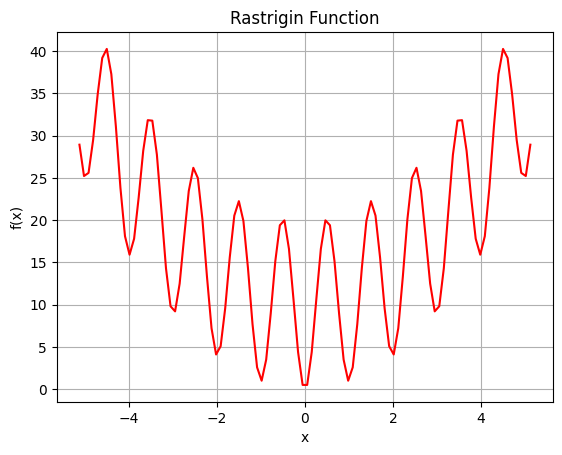

In [ ]:
plt.plot(x, f, 'r-')
plt.title('Rastrigin Function')
plt.xlabel('x')
plt.ylabel('f(x)')
plt.grid()
plt.show()

In [ ]:
def f(x):
  A = 10
  y = A + (x**2 - A * np.cos(2 * np.pi * x))
  return(y)

def df(x):
  A = 10
  y = 2*x + 2*np.pi*A*np.sin(2*np.pi*x)
  return(y)

In [ ]:
def mi_optimizador(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k])
  return(solucion,valor_obj,k)


In [ ]:
sol, f_obj, k = mi_optimizador(x0 = 0.25, g=f, g1p=df, lr = 0.1, tol = 0.0001)

In [ ]:
# Gráfica de la solución
plt.plot(x,y, 'r-',label = 'funcion')
plt.plot(sol,f_obj,'b*', label = 'solucion')
plt.title('Grafíca de $x^2 \cos(x)$')
plt.xlabel('$x$')
plt.legend()
plt.grid()
plt.show()

\#### Función Rosenbrock (Rosenbrock function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

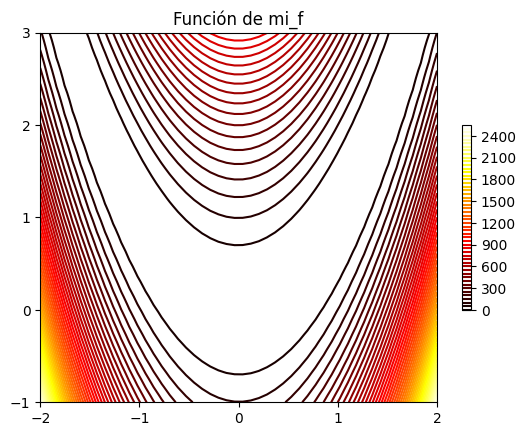

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

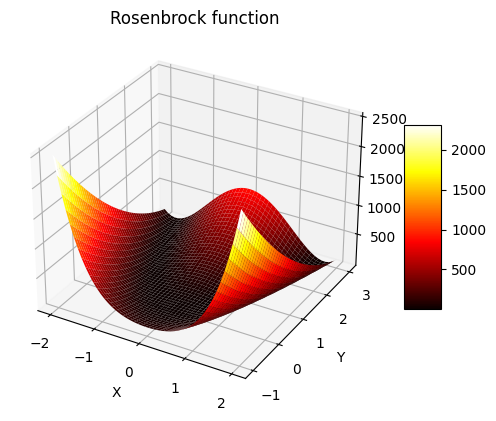

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

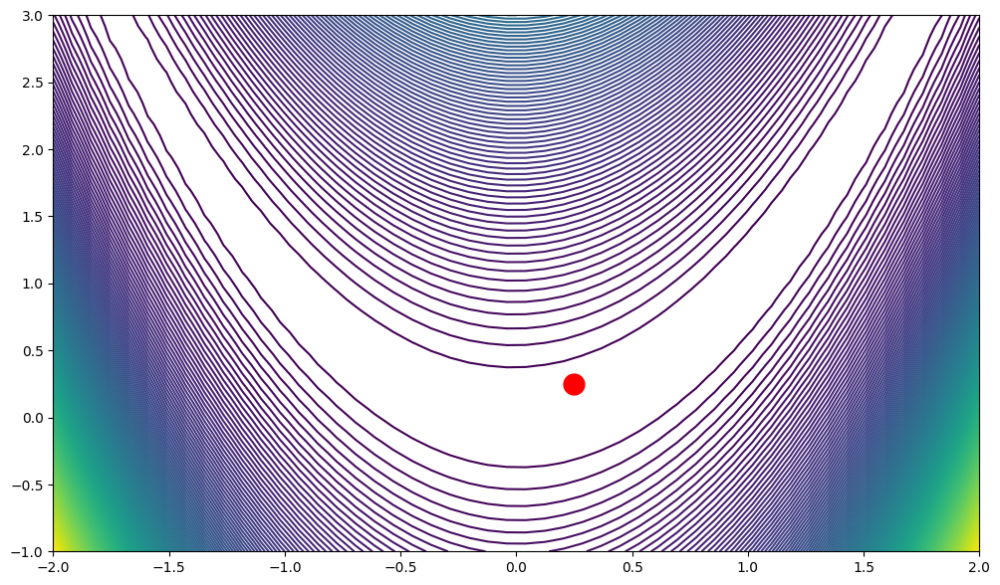

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-7-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-7-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

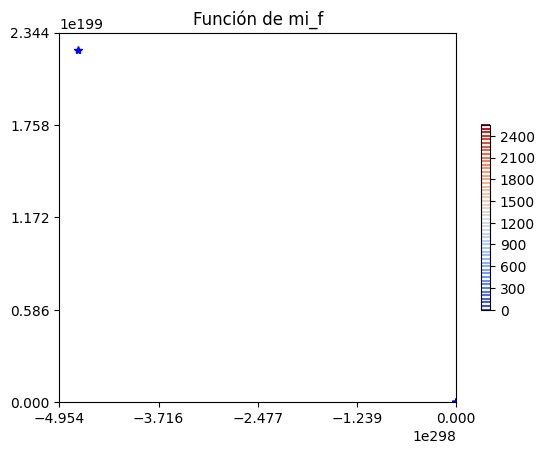

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


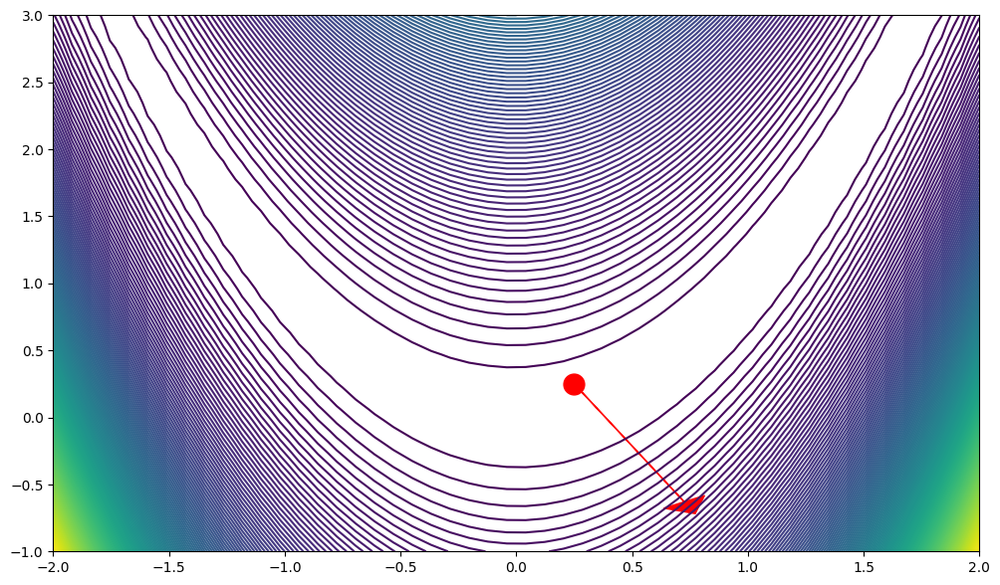

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


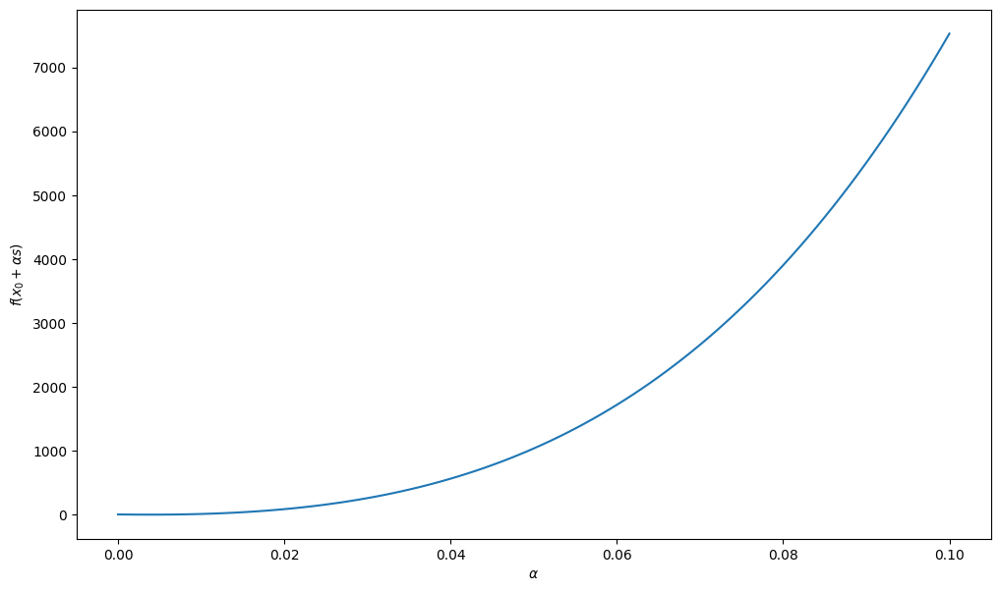

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

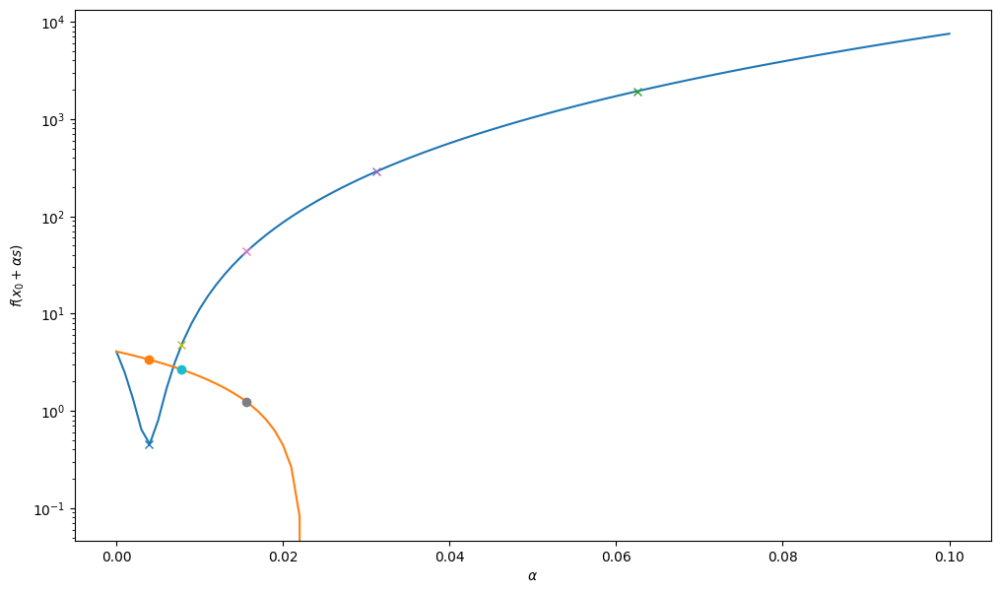

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

gen	nevals
0  	50    
1  	29    
2  	40    
3  	31    
4  	31    
5  	24    
6  	31    
7  	30    
8  	25    
9  	31    
10 	33    
11 	25    
12 	33    
13 	36    
14 	33    
15 	33    
16 	33    
17 	27    
18 	23    
19 	37    
20 	28    
21 	36    
22 	36    
23 	33    
24 	26    
25 	30    
26 	32    
27 	25    
28 	27    
29 	33    
30 	22    
31 	28    
32 	36    
33 	31    
34 	32    
35 	32    
36 	30    
37 	34    
38 	39    
39 	34    
40 	33    
41 	26    
42 	29    
43 	27    
44 	29    
45 	33    
46 	25    
47 	27    
48 	36    
49 	27    
50 	30    
51 	27    
52 	30    
53 	17    
54 	32    
55 	40    
56 	28    
57 	27    
58 	33    
59 	30    
60 	27    
61 	25    
62 	30    
63 	33    
64 	26    
65 	43    
66 	23    
67 	37    
68 	26    
69 	28    
70 	29    
71 	36    
72 	25    
73 	32    
74 	21    
75 	35    
76 	30    
77 	29    
78 	28    
79 	27    
80 	31    
81 	23    
82 	34    
83 	30    
84 	32    
85 	26    
86 	34    
87 	20    
88 	32    
89 	27    

##### Función Rosenbrock (Rosenbrock function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

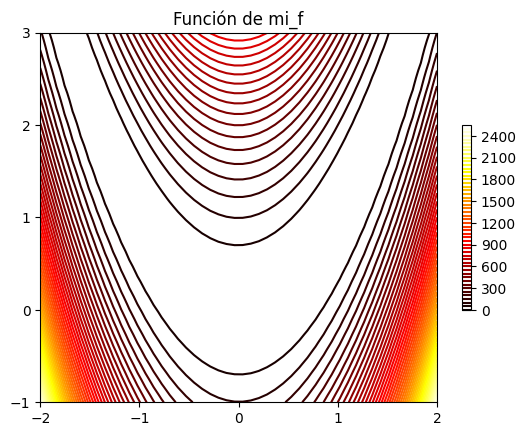

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

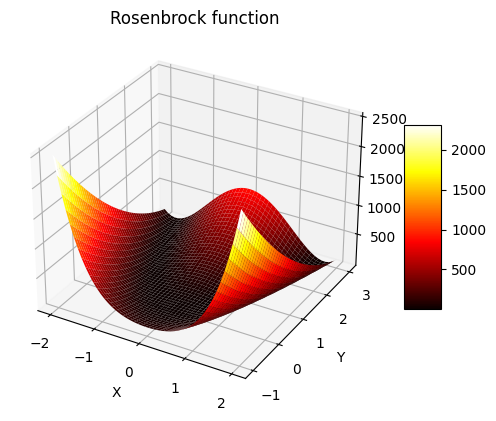

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

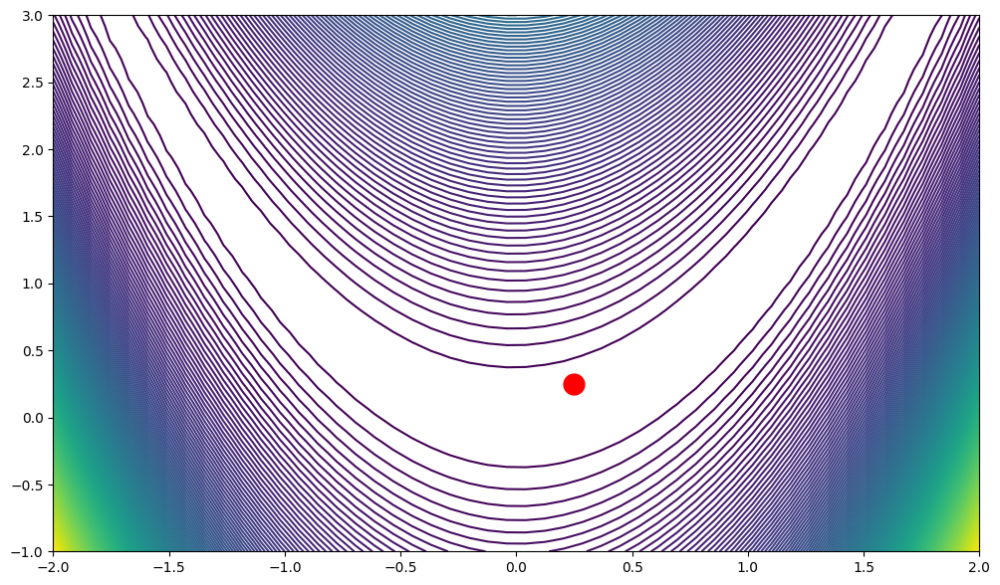

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-7-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-7-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

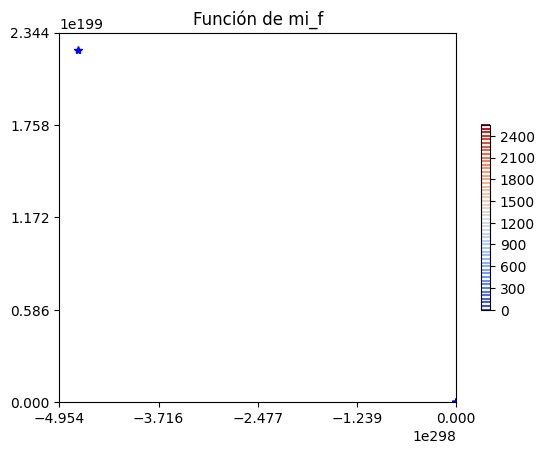

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


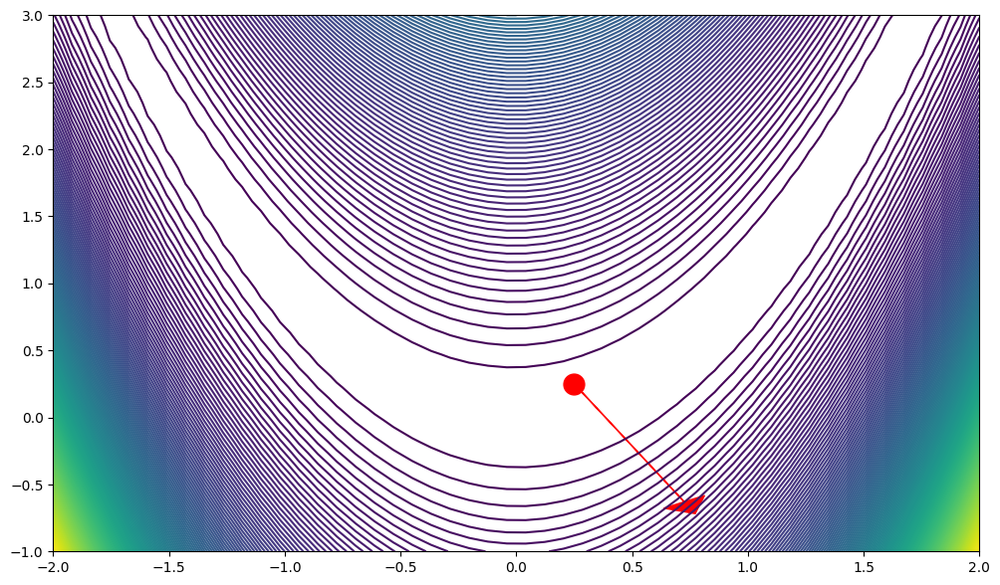

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


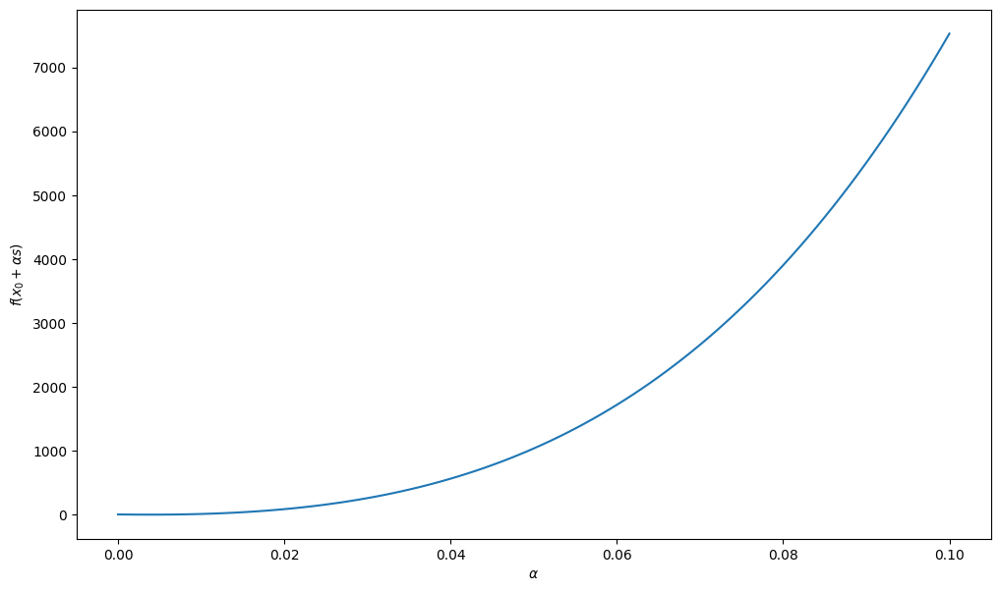

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

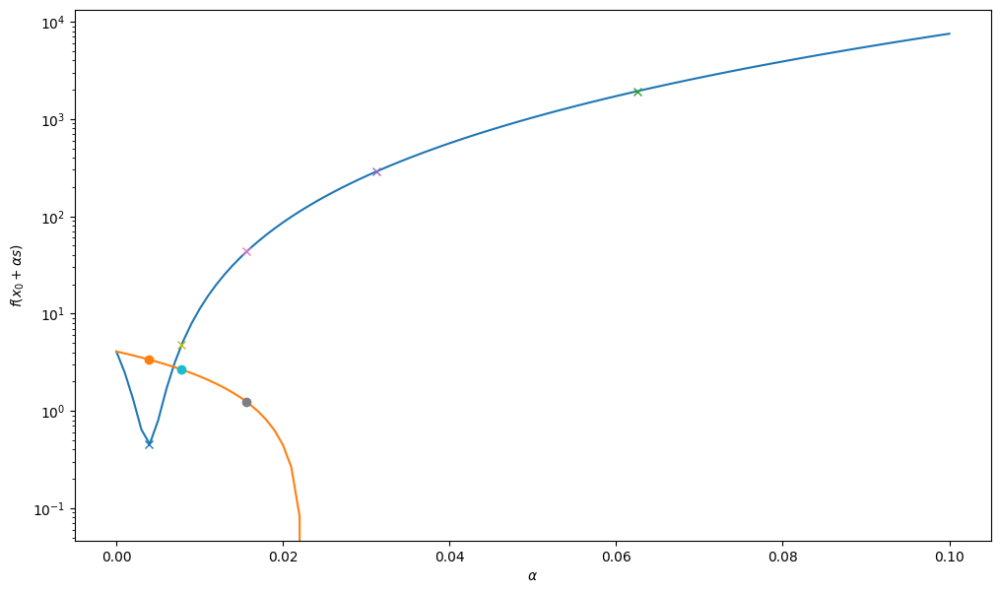

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

gen	nevals
0  	50    
1  	29    
2  	40    
3  	31    
4  	31    
5  	24    
6  	31    
7  	30    
8  	25    
9  	31    
10 	33    
11 	25    
12 	33    
13 	36    
14 	33    
15 	33    
16 	33    
17 	27    
18 	23    
19 	37    
20 	28    
21 	36    
22 	36    
23 	33    
24 	26    
25 	30    
26 	32    
27 	25    
28 	27    
29 	33    
30 	22    
31 	28    
32 	36    
33 	31    
34 	32    
35 	32    
36 	30    
37 	34    
38 	39    
39 	34    
40 	33    
41 	26    
42 	29    
43 	27    
44 	29    
45 	33    
46 	25    
47 	27    
48 	36    
49 	27    
50 	30    
51 	27    
52 	30    
53 	17    
54 	32    
55 	40    
56 	28    
57 	27    
58 	33    
59 	30    
60 	27    
61 	25    
62 	30    
63 	33    
64 	26    
65 	43    
66 	23    
67 	37    
68 	26    
69 	28    
70 	29    
71 	36    
72 	25    
73 	32    
74 	21    
75 	35    
76 	30    
77 	29    
78 	28    
79 	27    
80 	31    
81 	23    
82 	34    
83 	30    
84 	32    
85 	26    
86 	34    
87 	20    
88 	32    
89 	27    

##### Función Rastrigin (Rastrigin function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
A = 10
x = np.linspace(-5.12, 5.12, 100)
f = A + (x**2 - A * np.cos(2 * np.pi * x))

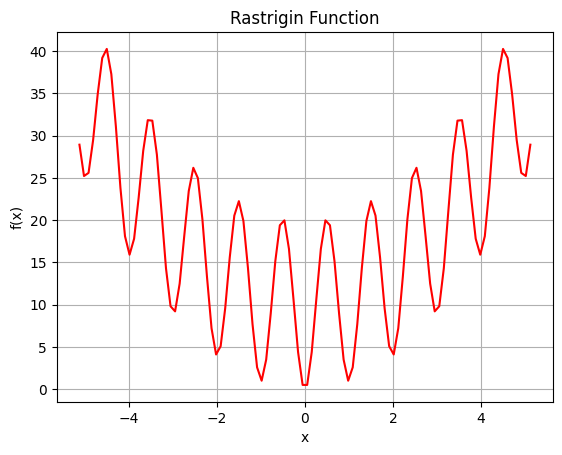

In [ ]:
plt.plot(x, f, 'r-')
plt.title('Rastrigin Function')
plt.xlabel('x')
plt.ylabel('f(x)')
plt.grid()
plt.show()

In [ ]:
def f(x):
  A = 10
  y = A + (x**2 - A * np.cos(2 * np.pi * x))
  return(y)

def df(x):
  A = 10
  y = 2*x + 2*np.pi*A*np.sin(2*np.pi*x)
  return(y)

In [ ]:
def mi_optimizador(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k])
  return(solucion,valor_obj,k)


In [ ]:
sol, f_obj, k = mi_optimizador(x0 = 0.25, g=f, g1p=df, lr = 0.1, tol = 0.0001)

In [ ]:
# Gráfica de la solución
plt.plot(x,y, 'r-',label = 'funcion')
plt.plot(sol,f_obj,'b*', label = 'solucion')
plt.title('Grafíca de $x^2 \cos(x)$')
plt.xlabel('$x$')
plt.legend()
plt.grid()
plt.show()

\#### Función Rosenbrock (Rosenbrock function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

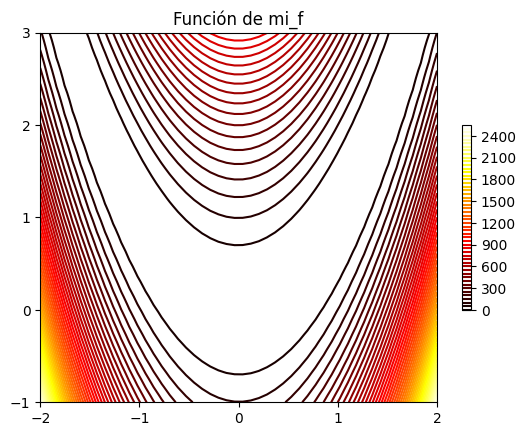

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

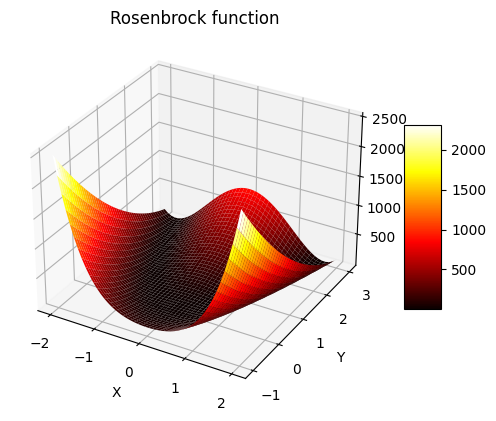

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

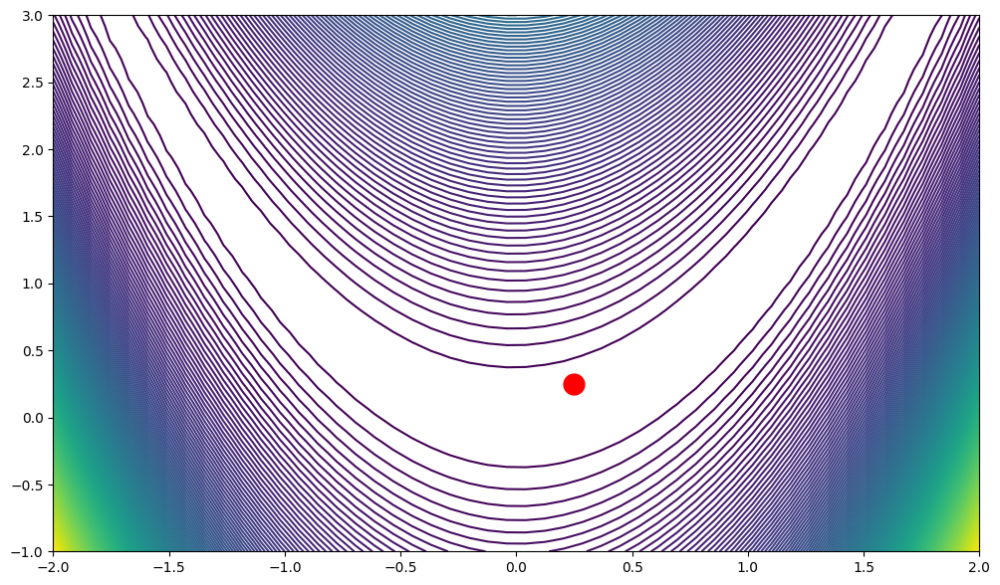

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-7-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-7-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

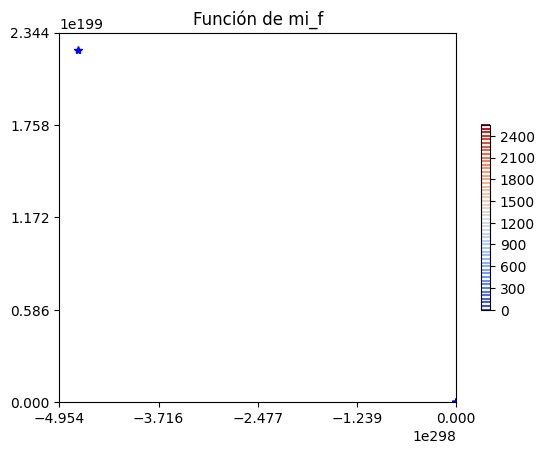

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


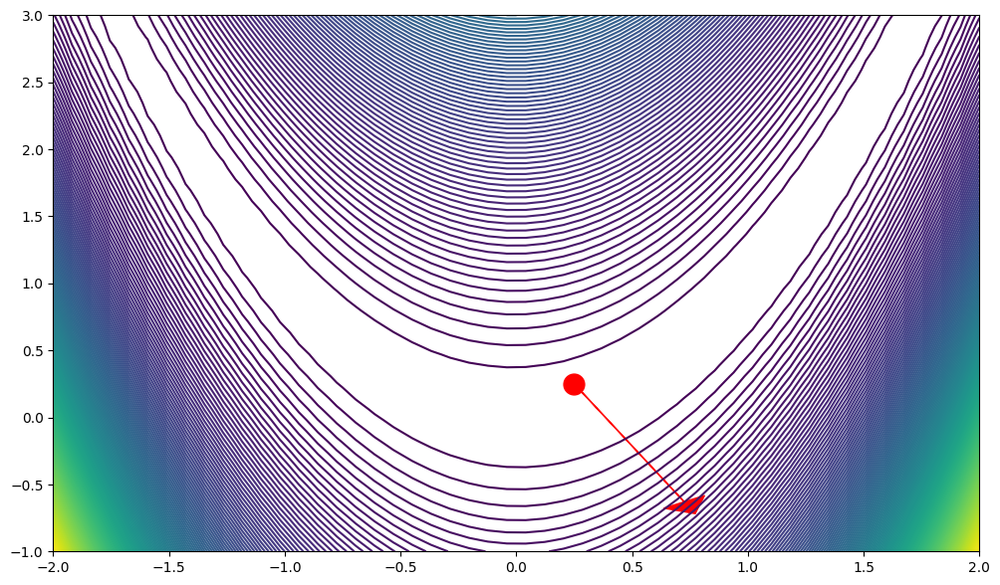

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


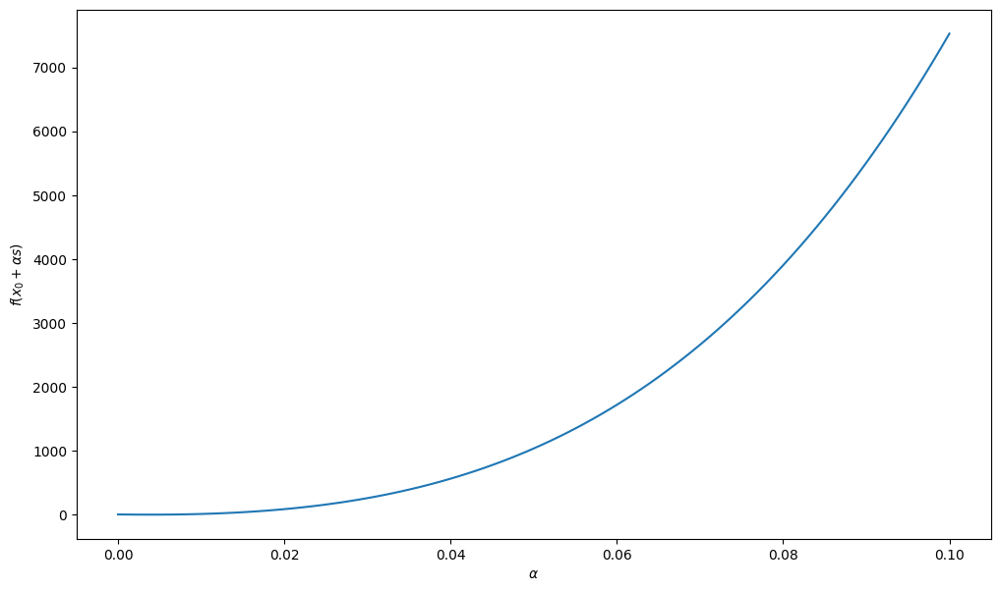

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

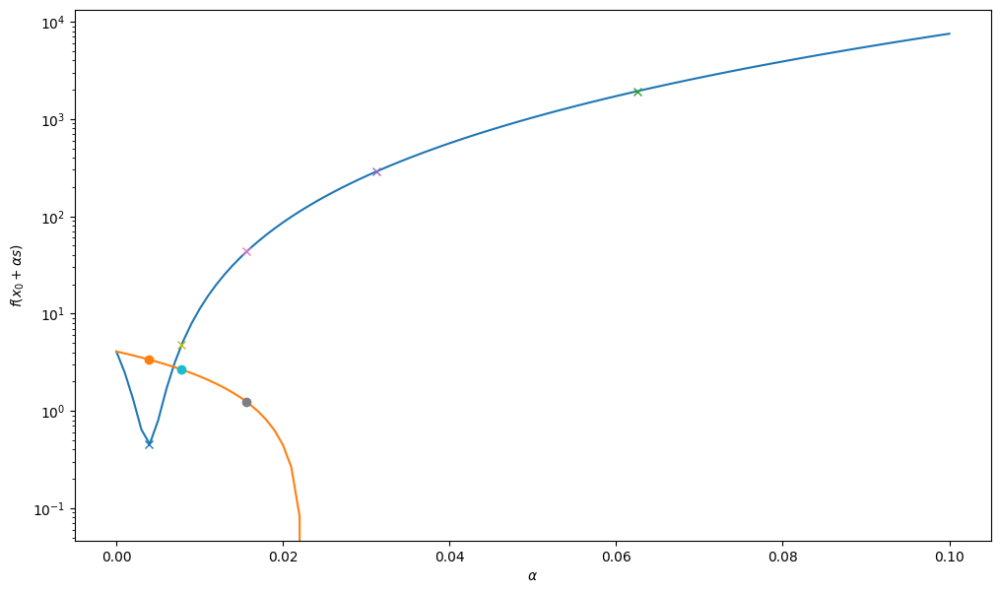

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

gen	nevals
0  	50    
1  	29    
2  	40    
3  	31    
4  	31    
5  	24    
6  	31    
7  	30    
8  	25    
9  	31    
10 	33    
11 	25    
12 	33    
13 	36    
14 	33    
15 	33    
16 	33    
17 	27    
18 	23    
19 	37    
20 	28    
21 	36    
22 	36    
23 	33    
24 	26    
25 	30    
26 	32    
27 	25    
28 	27    
29 	33    
30 	22    
31 	28    
32 	36    
33 	31    
34 	32    
35 	32    
36 	30    
37 	34    
38 	39    
39 	34    
40 	33    
41 	26    
42 	29    
43 	27    
44 	29    
45 	33    
46 	25    
47 	27    
48 	36    
49 	27    
50 	30    
51 	27    
52 	30    
53 	17    
54 	32    
55 	40    
56 	28    
57 	27    
58 	33    
59 	30    
60 	27    
61 	25    
62 	30    
63 	33    
64 	26    
65 	43    
66 	23    
67 	37    
68 	26    
69 	28    
70 	29    
71 	36    
72 	25    
73 	32    
74 	21    
75 	35    
76 	30    
77 	29    
78 	28    
79 	27    
80 	31    
81 	23    
82 	34    
83 	30    
84 	32    
85 	26    
86 	34    
87 	20    
88 	32    
89 	27    

#### Optimización de funciones de prueba - Método de evolución diferencial.

##### Función Rosenbrock (Rosenbrock function) - 2 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

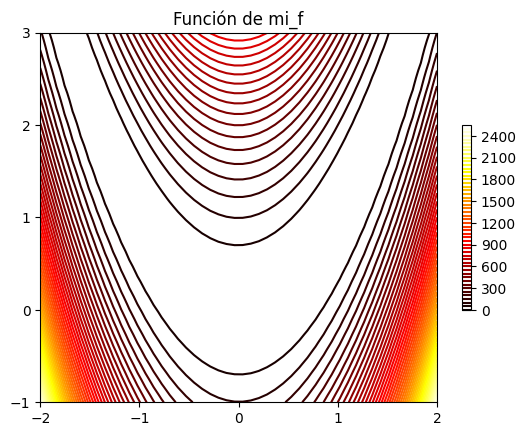

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

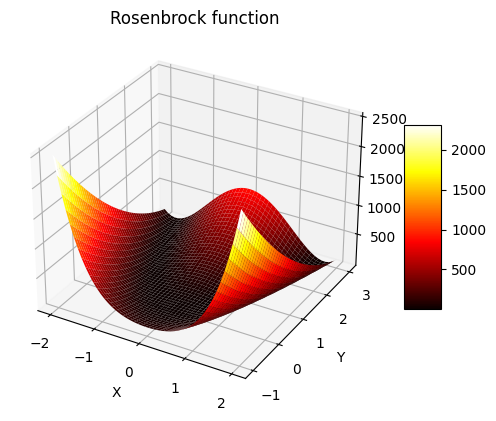

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

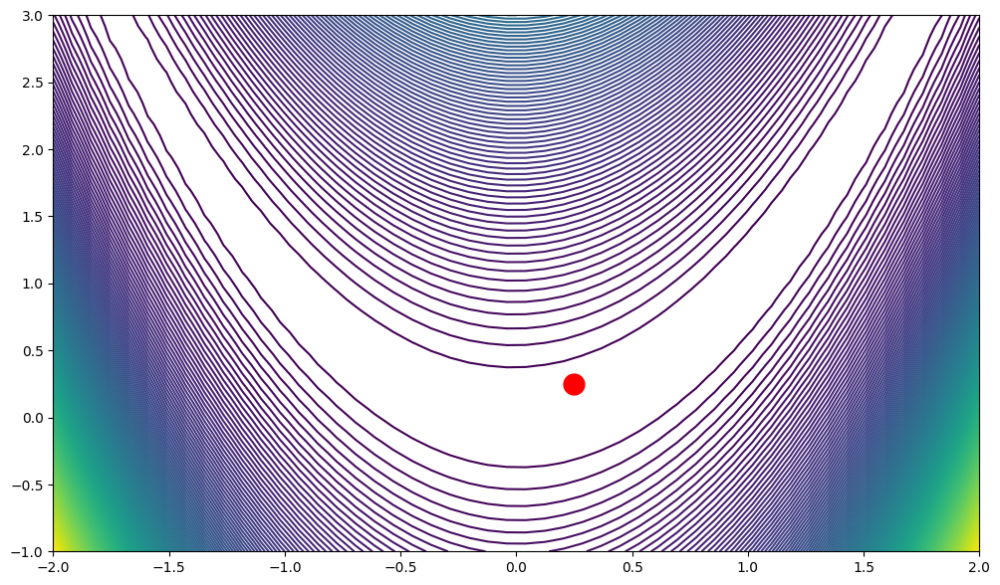

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-7-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-7-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

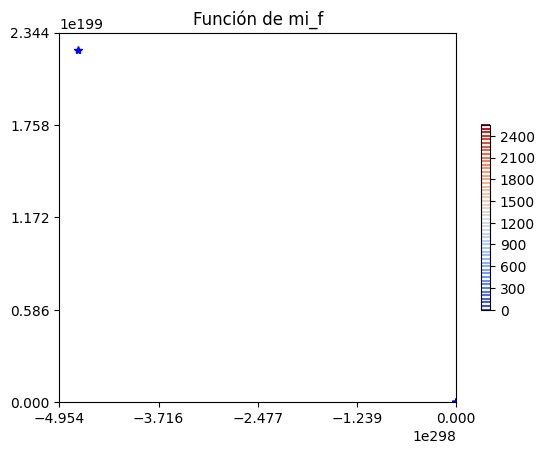

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


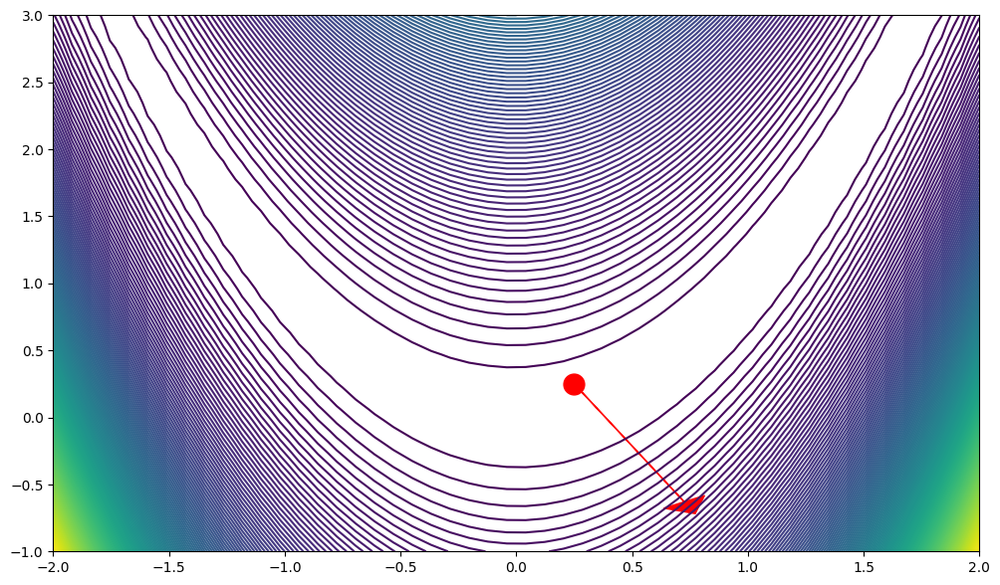

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


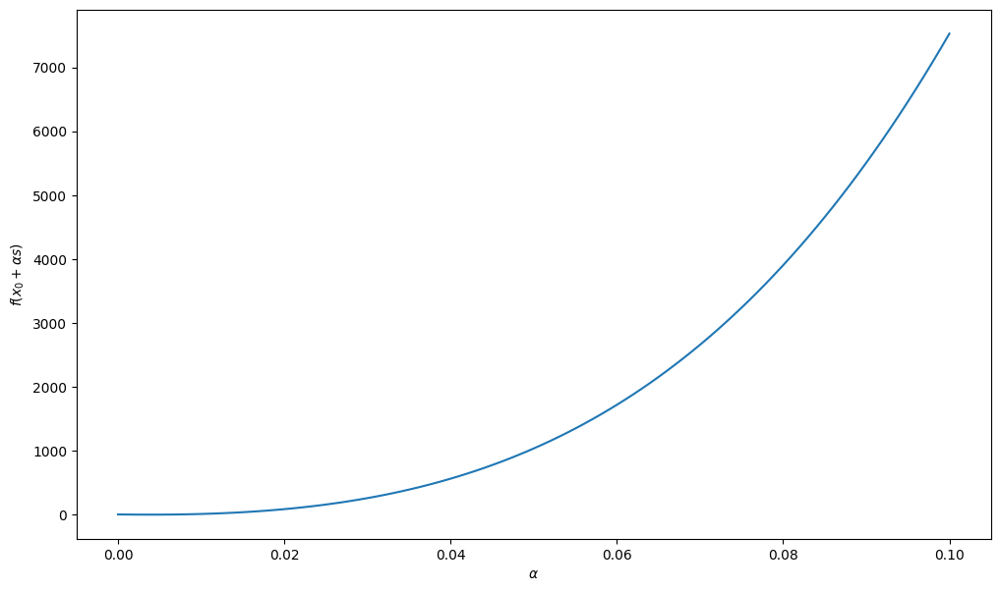

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

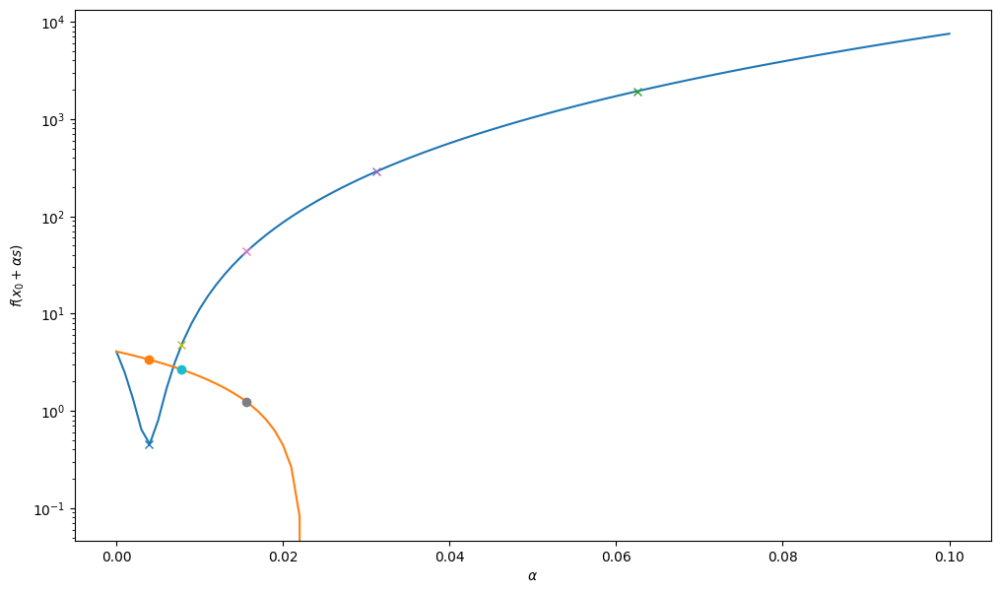

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

gen	nevals
0  	50    
1  	29    
2  	40    
3  	31    
4  	31    
5  	24    
6  	31    
7  	30    
8  	25    
9  	31    
10 	33    
11 	25    
12 	33    
13 	36    
14 	33    
15 	33    
16 	33    
17 	27    
18 	23    
19 	37    
20 	28    
21 	36    
22 	36    
23 	33    
24 	26    
25 	30    
26 	32    
27 	25    
28 	27    
29 	33    
30 	22    
31 	28    
32 	36    
33 	31    
34 	32    
35 	32    
36 	30    
37 	34    
38 	39    
39 	34    
40 	33    
41 	26    
42 	29    
43 	27    
44 	29    
45 	33    
46 	25    
47 	27    
48 	36    
49 	27    
50 	30    
51 	27    
52 	30    
53 	17    
54 	32    
55 	40    
56 	28    
57 	27    
58 	33    
59 	30    
60 	27    
61 	25    
62 	30    
63 	33    
64 	26    
65 	43    
66 	23    
67 	37    
68 	26    
69 	28    
70 	29    
71 	36    
72 	25    
73 	32    
74 	21    
75 	35    
76 	30    
77 	29    
78 	28    
79 	27    
80 	31    
81 	23    
82 	34    
83 	30    
84 	32    
85 	26    
86 	34    
87 	20    
88 	32    
89 	27    

##### Función Rastrigin (Rastrigin function) - 2 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
A = 10
x = np.linspace(-5.12, 5.12, 100)
f = A + (x**2 - A * np.cos(2 * np.pi * x))

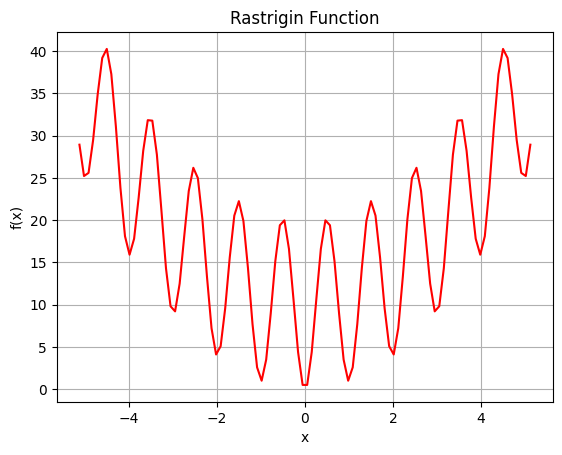

In [ ]:
plt.plot(x, f, 'r-')
plt.title('Rastrigin Function')
plt.xlabel('x')
plt.ylabel('f(x)')
plt.grid()
plt.show()

In [ ]:
def f(x):
  A = 10
  y = A + (x**2 - A * np.cos(2 * np.pi * x))
  return(y)

def df(x):
  A = 10
  y = 2*x + 2*np.pi*A*np.sin(2*np.pi*x)
  return(y)

In [ ]:
def mi_optimizador(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k])
  return(solucion,valor_obj,k)


In [ ]:
sol, f_obj, k = mi_optimizador(x0 = 0.25, g=f, g1p=df, lr = 0.1, tol = 0.0001)

In [ ]:
# Gráfica de la solución
plt.plot(x,y, 'r-',label = 'funcion')
plt.plot(sol,f_obj,'b*', label = 'solucion')
plt.title('Grafíca de $x^2 \cos(x)$')
plt.xlabel('$x$')
plt.legend()
plt.grid()
plt.show()

\#### Función Rosenbrock (Rosenbrock function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

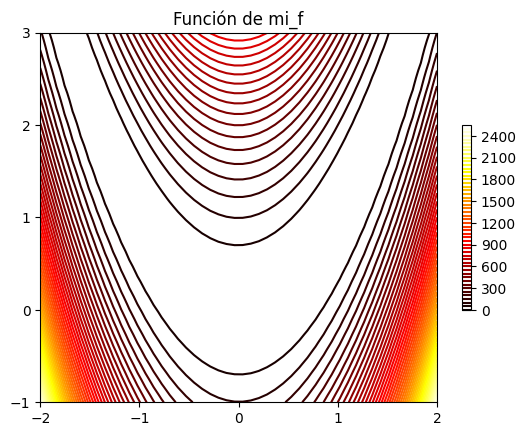

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

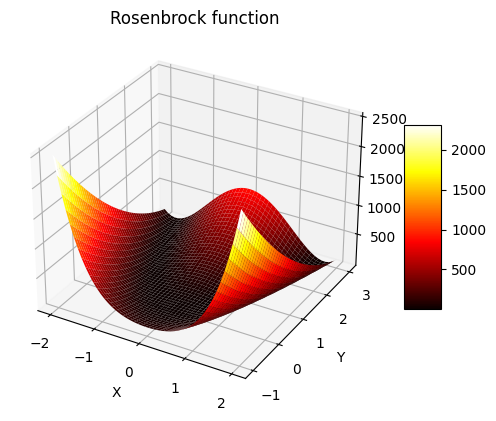

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

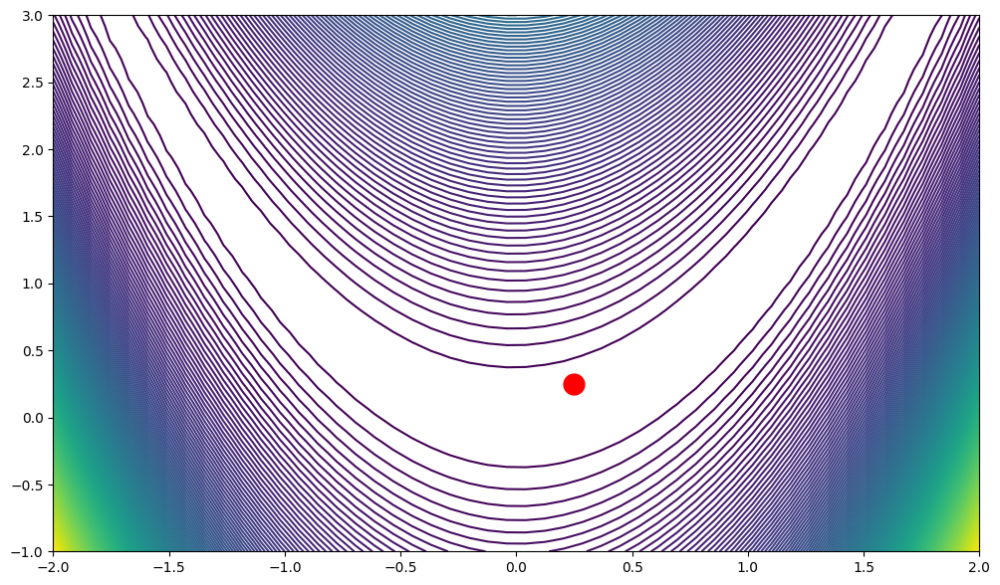

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-7-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-7-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

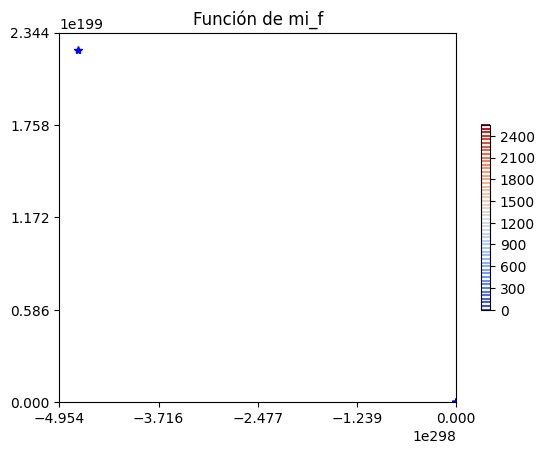

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


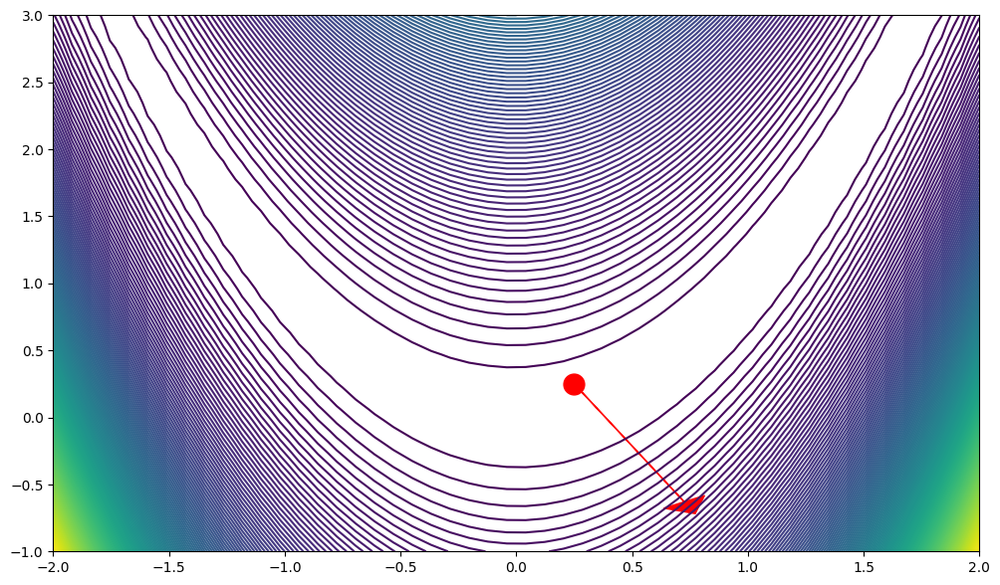

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


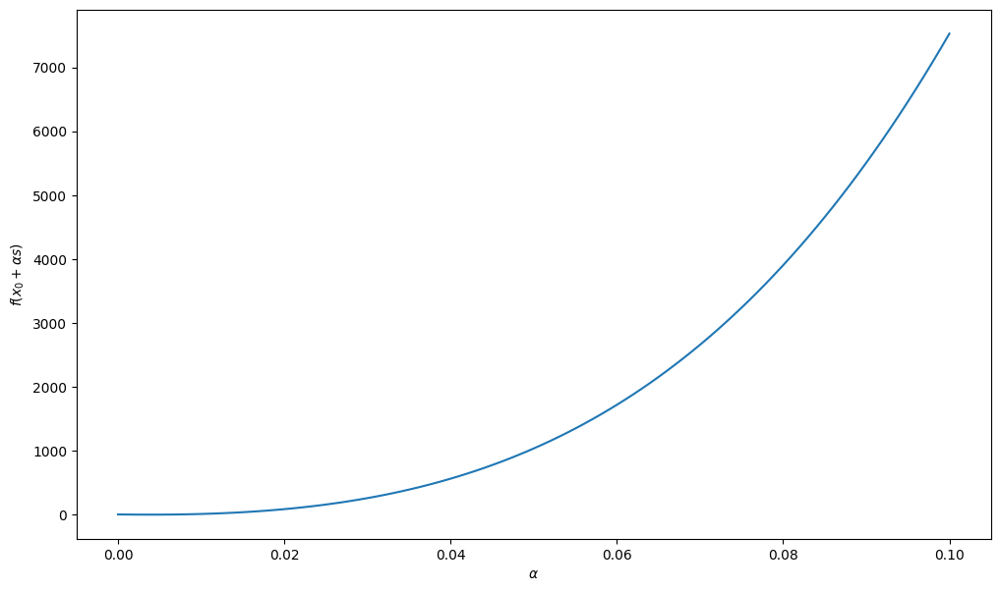

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

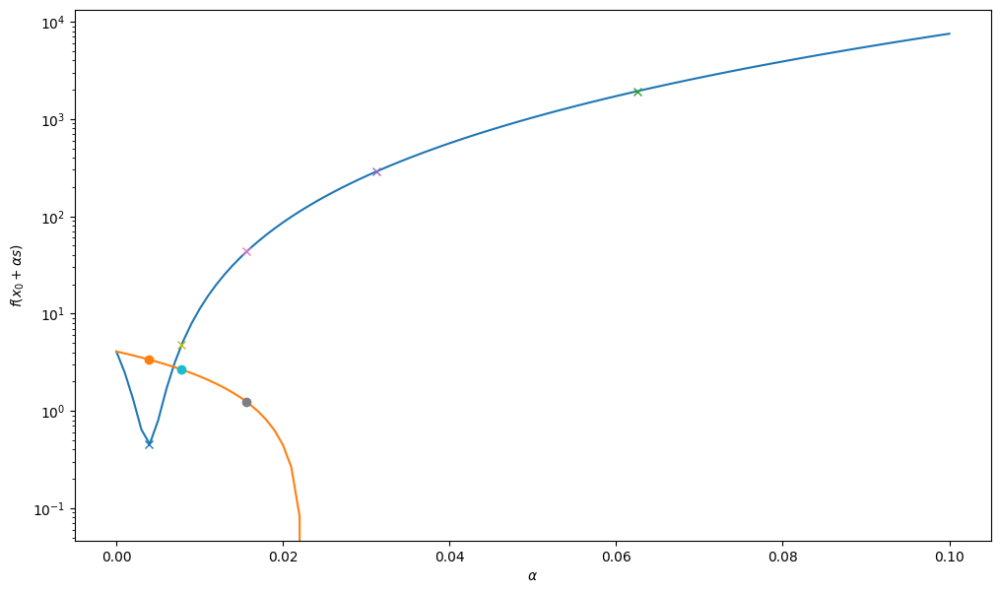

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

gen	nevals
0  	50    
1  	29    
2  	40    
3  	31    
4  	31    
5  	24    
6  	31    
7  	30    
8  	25    
9  	31    
10 	33    
11 	25    
12 	33    
13 	36    
14 	33    
15 	33    
16 	33    
17 	27    
18 	23    
19 	37    
20 	28    
21 	36    
22 	36    
23 	33    
24 	26    
25 	30    
26 	32    
27 	25    
28 	27    
29 	33    
30 	22    
31 	28    
32 	36    
33 	31    
34 	32    
35 	32    
36 	30    
37 	34    
38 	39    
39 	34    
40 	33    
41 	26    
42 	29    
43 	27    
44 	29    
45 	33    
46 	25    
47 	27    
48 	36    
49 	27    
50 	30    
51 	27    
52 	30    
53 	17    
54 	32    
55 	40    
56 	28    
57 	27    
58 	33    
59 	30    
60 	27    
61 	25    
62 	30    
63 	33    
64 	26    
65 	43    
66 	23    
67 	37    
68 	26    
69 	28    
70 	29    
71 	36    
72 	25    
73 	32    
74 	21    
75 	35    
76 	30    
77 	29    
78 	28    
79 	27    
80 	31    
81 	23    
82 	34    
83 	30    
84 	32    
85 	26    
86 	34    
87 	20    
88 	32    
89 	27    

##### Función Rosenbrock (Rosenbrock function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

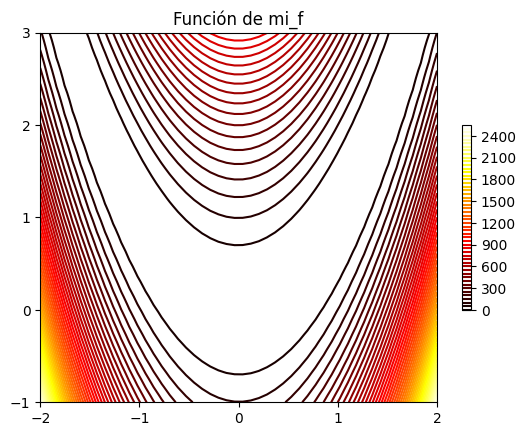

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

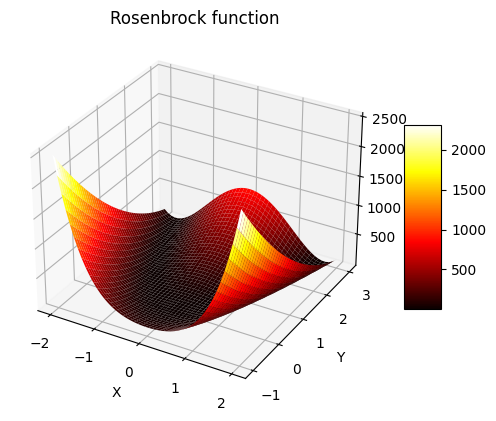

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

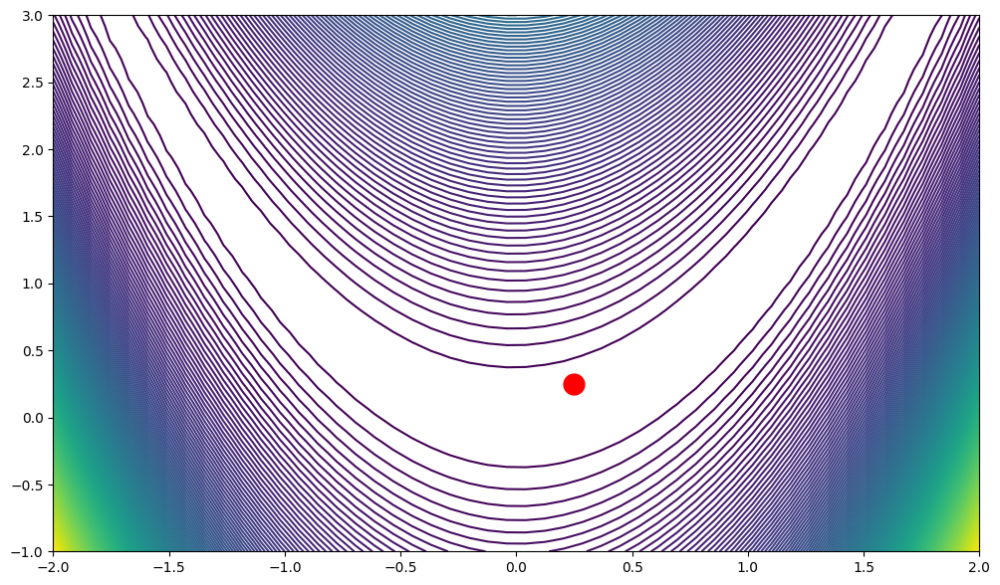

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-7-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-7-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

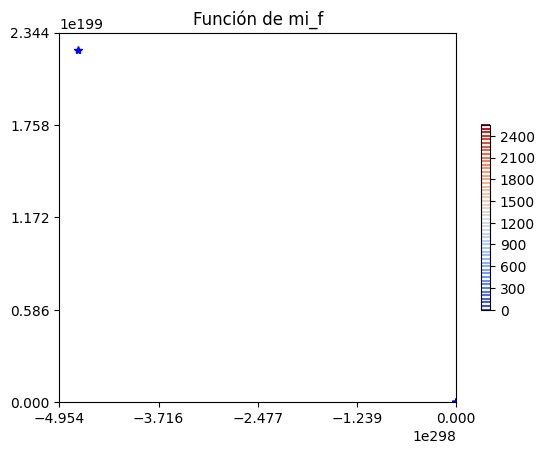

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


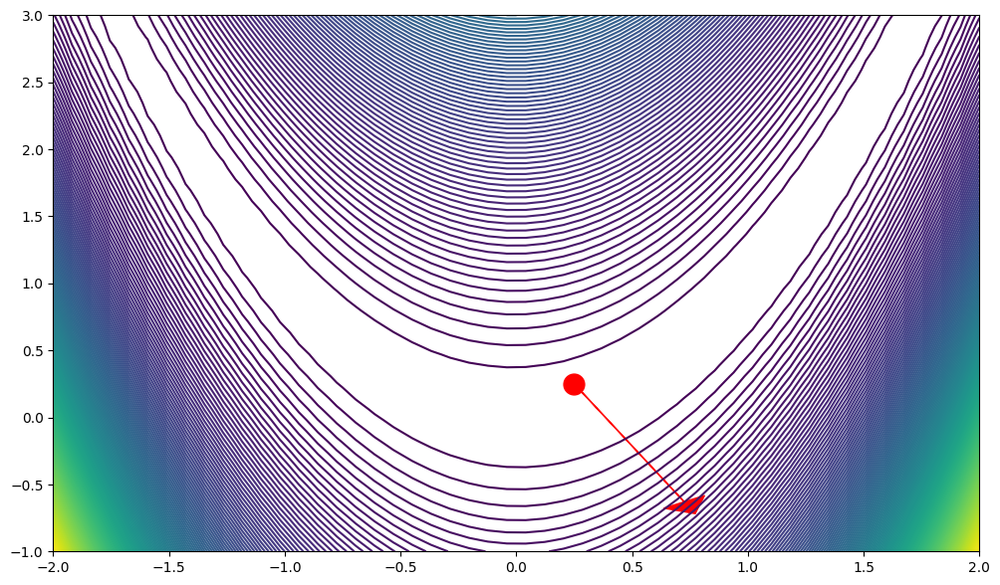

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


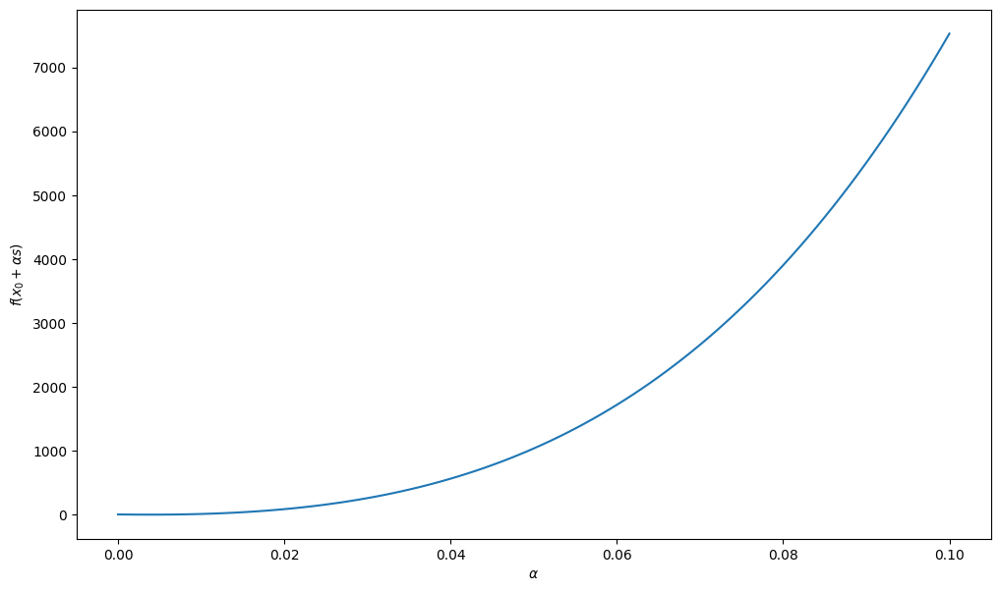

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

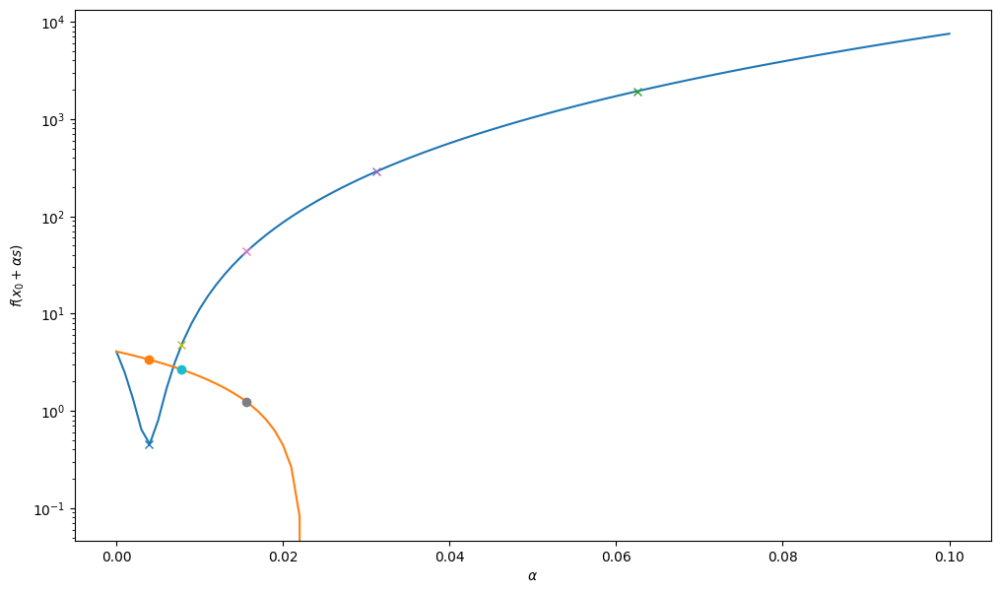

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

gen	nevals
0  	50    
1  	29    
2  	40    
3  	31    
4  	31    
5  	24    
6  	31    
7  	30    
8  	25    
9  	31    
10 	33    
11 	25    
12 	33    
13 	36    
14 	33    
15 	33    
16 	33    
17 	27    
18 	23    
19 	37    
20 	28    
21 	36    
22 	36    
23 	33    
24 	26    
25 	30    
26 	32    
27 	25    
28 	27    
29 	33    
30 	22    
31 	28    
32 	36    
33 	31    
34 	32    
35 	32    
36 	30    
37 	34    
38 	39    
39 	34    
40 	33    
41 	26    
42 	29    
43 	27    
44 	29    
45 	33    
46 	25    
47 	27    
48 	36    
49 	27    
50 	30    
51 	27    
52 	30    
53 	17    
54 	32    
55 	40    
56 	28    
57 	27    
58 	33    
59 	30    
60 	27    
61 	25    
62 	30    
63 	33    
64 	26    
65 	43    
66 	23    
67 	37    
68 	26    
69 	28    
70 	29    
71 	36    
72 	25    
73 	32    
74 	21    
75 	35    
76 	30    
77 	29    
78 	28    
79 	27    
80 	31    
81 	23    
82 	34    
83 	30    
84 	32    
85 	26    
86 	34    
87 	20    
88 	32    
89 	27    

##### Función Rastrigin (Rastrigin function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
A = 10
x = np.linspace(-5.12, 5.12, 100)
f = A + (x**2 - A * np.cos(2 * np.pi * x))

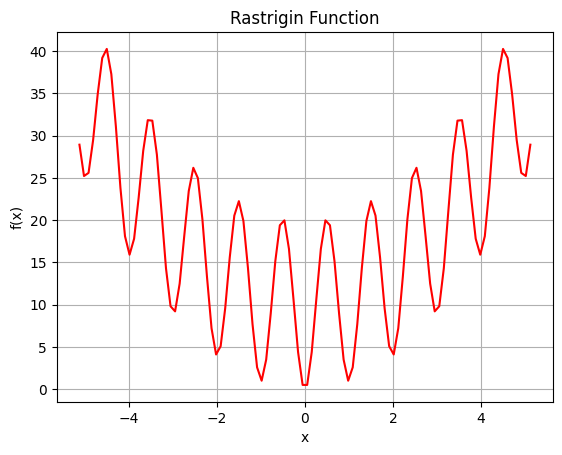

In [ ]:
plt.plot(x, f, 'r-')
plt.title('Rastrigin Function')
plt.xlabel('x')
plt.ylabel('f(x)')
plt.grid()
plt.show()

In [ ]:
def f(x):
  A = 10
  y = A + (x**2 - A * np.cos(2 * np.pi * x))
  return(y)

def df(x):
  A = 10
  y = 2*x + 2*np.pi*A*np.sin(2*np.pi*x)
  return(y)

In [ ]:
def mi_optimizador(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k])
  return(solucion,valor_obj,k)


In [ ]:
sol, f_obj, k = mi_optimizador(x0 = 0.25, g=f, g1p=df, lr = 0.1, tol = 0.0001)

In [ ]:
# Gráfica de la solución
plt.plot(x,y, 'r-',label = 'funcion')
plt.plot(sol,f_obj,'b*', label = 'solucion')
plt.title('Grafíca de $x^2 \cos(x)$')
plt.xlabel('$x$')
plt.legend()
plt.grid()
plt.show()

\#### Función Rosenbrock (Rosenbrock function) - 3 Dimensiones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2

ncols = 50
nrows = 50
x = np.linspace(-2, 2, ncols)
y = np.linspace(-1, 3, nrows)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
Z = np.array(Z).reshape([nrows,ncols])

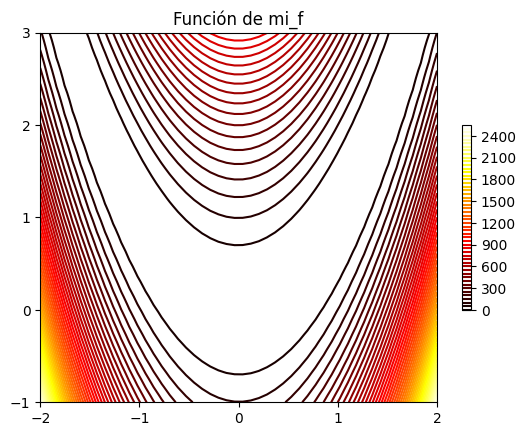

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap='hot')
plt.title("Función de mi_f")
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

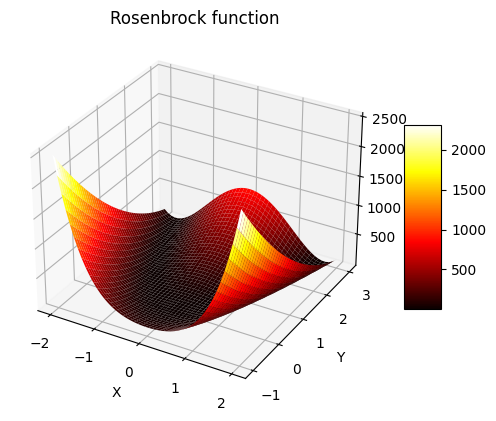

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d', title='Rosenbrock function')
surf = ax.plot_surface(X, Y, Z, cmap='hot')
fig.colorbar(surf, shrink=0.5, aspect=5)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

In [ ]:
df = lambda x,y: np.array([2*(x-1) - 4*100*(y - x**2)*x, 2*100*(y-x**2)])

In [ ]:
F = lambda X: f(X[0],X[1])
dF = lambda X: df(X[0],X[1])

In [ ]:
x0 = np.array([0.25,0.25])
print(F(x0))
print(dF(x0))

4.078125
[-20.25  37.5 ]


Ahora definiremos el método de optimización multivariado. Observemos que tiene muy pocas modificaciones respecto a la función que habíamos definido previamente.

In [ ]:
def mi_optimizador_ndim(x0, g, g1p, lr = 0.001, tol = 0.0000001, max_iter = 100):
  solucion = list()
  valor_obj = list()
  k = 0
  solucion.append(x0)
  valor_obj.append(g(x0))
  delta_sol = 1
  while (delta_sol>tol) | (k>max_iter):
    x_new = solucion[k] - lr * g1p(solucion[k])
    solucion.append(x_new)
    valor_obj.append(g(x_new))
    k=k+1
    delta_sol = np.abs(solucion[k-1] - solucion[k]).max()
  return(solucion,valor_obj,k)

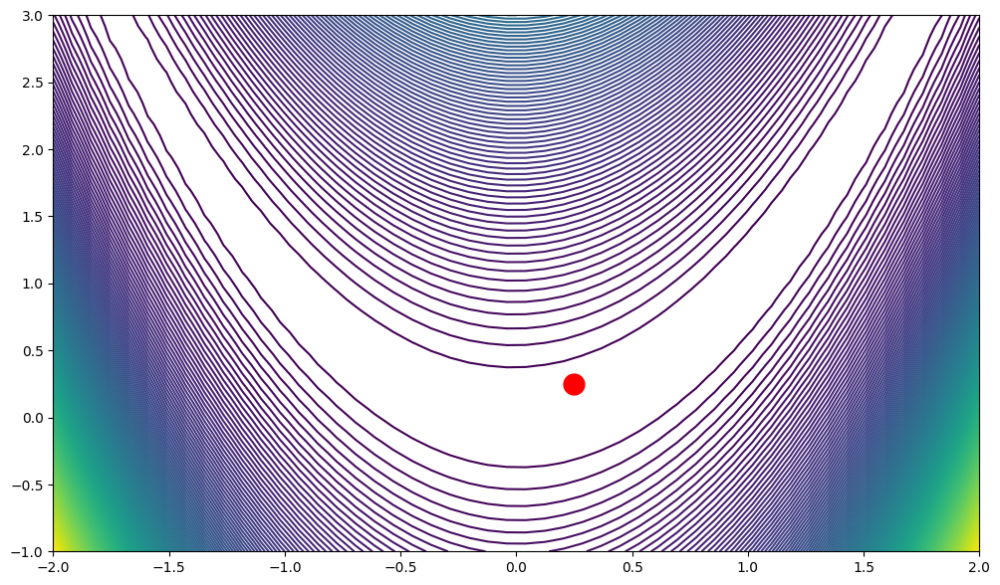

In [ ]:
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')

Ahora llevemos a cabo la optimización numérica con el gradiente explícito.

In [ ]:
# Optimización numérica con gradiente explícito:
sol, f_obj, k = mi_optimizador_ndim(x0 = x0, g=F, g1p=dF, lr = 0.1, tol = 0.0001)

<ipython-input-7-05506707f21a>:1: RuntimeWarning: overflow encountered in scalar power
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2
<ipython-input-7-05506707f21a>:1: RuntimeWarning: invalid value encountered in scalar subtract
  f = lambda x,y: (x - 1)**2 + 100*(y - x**2)**2


Veamos el resultado:

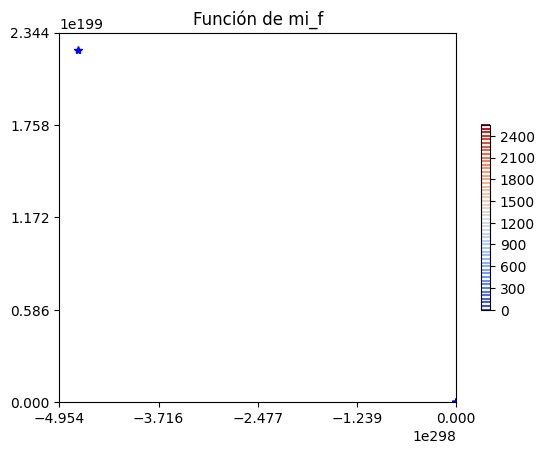

In [ ]:
fig, ax = plt.subplots()
contorno = ax.contour(X,Y,Z, levels = 50, cmap=cm.coolwarm)
plt.title("Función de mi_f")
for i in range(len(sol)):
  plt.plot(sol[i][0],sol[i][1],'b*')
# Add a color bar which maps values to colors.
ax.yaxis.set_major_locator(LinearLocator(5))
ax.xaxis.set_major_locator(LinearLocator(5))
fig.colorbar(contorno, shrink=0.5, aspect=20)
plt.show()

In [ ]:
fx = F(x0);
gx = dF(x0);
s = -gx;
print(s)

[ 20.25 -37.5 ]


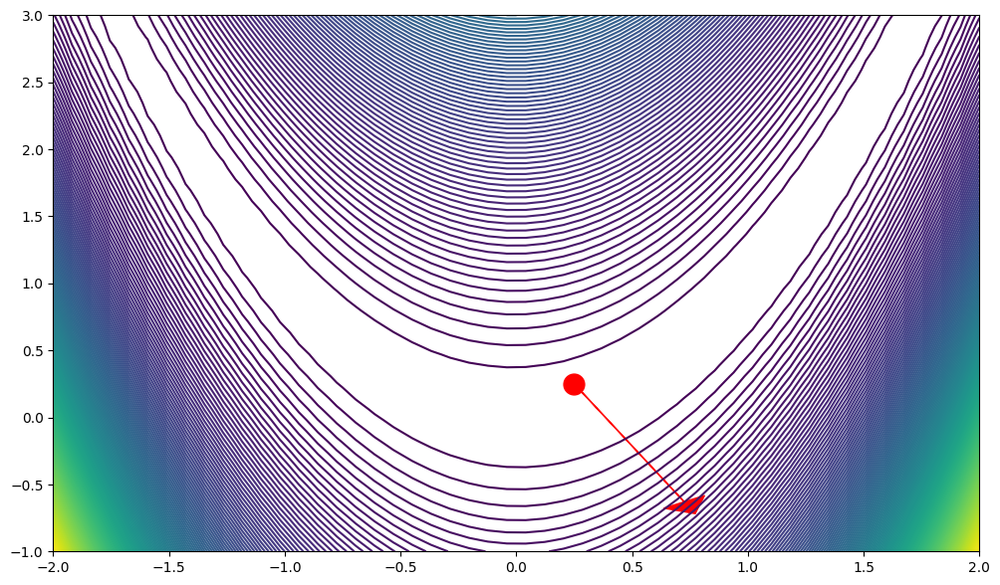

In [ ]:
# Initialize figure
plt.figure(figsize=(12, 7))
plt.contour(X,Y,Z,200)
ns = np.sqrt(s[0]**2+s[1]**2);
plt.plot([x0[0]],[x0[1]],marker='o',markersize=15, color ='r')
plt.arrow(x0[0],x0[1],s[0]/ns,s[1]/ns, head_width=0.2, head_length=0.1, fc='r', ec='r')


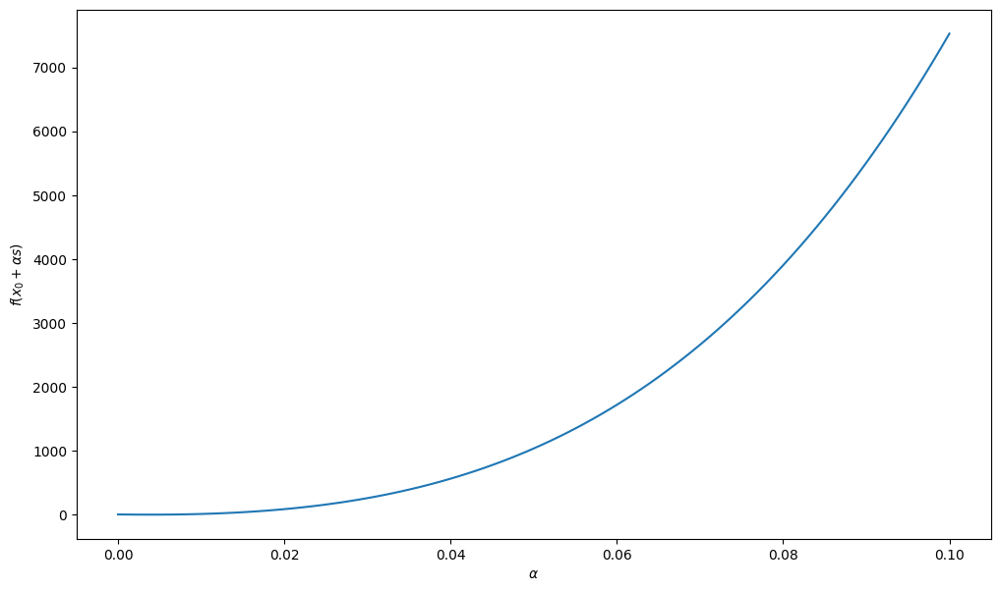

In [ ]:
al = np.linspace(0,0.1,101)
z = [F(x0+a*s) for a in al]
figLS = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

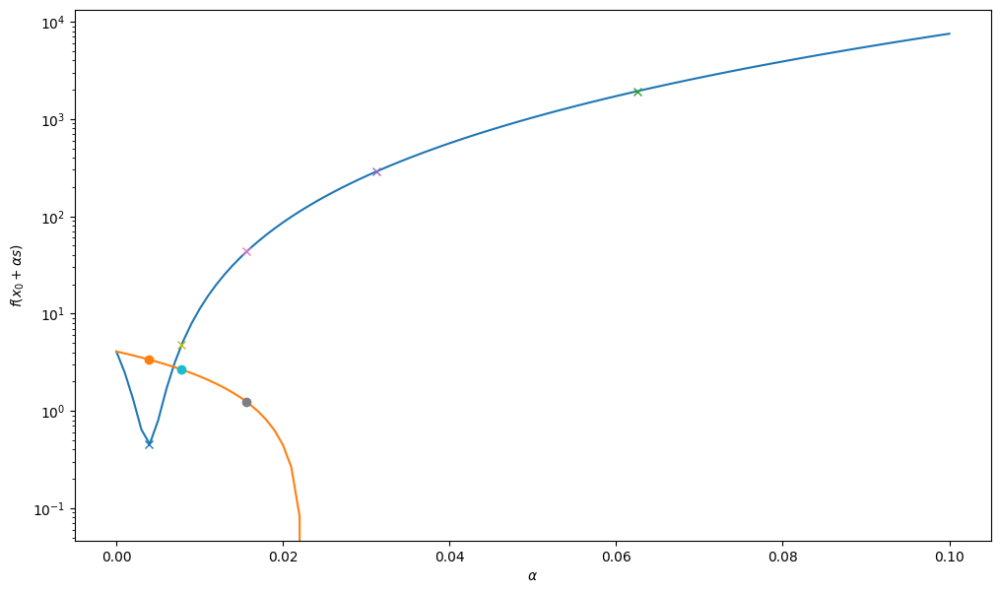

In [ ]:
theta = 0.1
alpha = 1
tol = 1e-10
d = theta*np.dot(gx,s)

figLS1 = plt.figure(figsize=(12, 7))
plt.plot(al,z)
plt.plot(al,[fx+a*d for a in al])

for i in range(10):

    if (alpha<=0.1):
        plt.plot(alpha,F(x0+alpha*s),marker='x');
        plt.plot(alpha,fx + alpha*d,marker='o')

    if F(x0+alpha*s) < (fx + alpha*d):
        break;
    alpha = alpha/2;

plt.yscale('log')
plt.ylabel('$f(x_0+ \\alpha s)$')
plt.xlabel('$\\alpha$')
plt.show()

In [ ]:
[fx,fx+0.01*d]


[4.078125, 2.2618124999999996]

In [ ]:
alpha


0.00390625

In [ ]:
from scipy.optimize import minimize
result = minimize(F, x0, method='BFGS')

# Imprimir los resultados
print("Resultado de descenso por gradiente:")
print(result.x)
print("Valor mínimo encontrado:")
print(result.fun)

Resultado de descenso por gradiente:
[0.99999512 0.99999022]
Valor mínimo encontrado:
2.3840278145895232e-11


In [ ]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import random
from deap import base, creator, tools, algorithms

# Definir la función de evaluación
def eval_rosenbrock(individual):
    x, y = individual
    return (f(x, y),)

# Configurar el entorno de DEAP
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)
toolbox = base.Toolbox()
toolbox.register("attr_float", random.uniform, -2, 2)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_float, n=2)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxBlend, alpha=0.5)
toolbox.register("mutate", tools.mutGaussian, mu=0, sigma=0.2, indpb=0.2)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", eval_rosenbrock)

# Configurar parámetros y ejecutar el algoritmo evolutivo
population = toolbox.population(n=50)
algorithms.eaSimple(population, toolbox, cxpb=0.5, mutpb=0.2, ngen=1000, verbose=True)

# Imprimir los resultados
best_individual = tools.selBest(population, k=1)[0]
print("Mejor individuo encontrado:")
print(best_individual)
print("Valor mínimo encontrado:")
print(best_individual.fitness.values[0])

gen	nevals
0  	50    
1  	29    
2  	40    
3  	31    
4  	31    
5  	24    
6  	31    
7  	30    
8  	25    
9  	31    
10 	33    
11 	25    
12 	33    
13 	36    
14 	33    
15 	33    
16 	33    
17 	27    
18 	23    
19 	37    
20 	28    
21 	36    
22 	36    
23 	33    
24 	26    
25 	30    
26 	32    
27 	25    
28 	27    
29 	33    
30 	22    
31 	28    
32 	36    
33 	31    
34 	32    
35 	32    
36 	30    
37 	34    
38 	39    
39 	34    
40 	33    
41 	26    
42 	29    
43 	27    
44 	29    
45 	33    
46 	25    
47 	27    
48 	36    
49 	27    
50 	30    
51 	27    
52 	30    
53 	17    
54 	32    
55 	40    
56 	28    
57 	27    
58 	33    
59 	30    
60 	27    
61 	25    
62 	30    
63 	33    
64 	26    
65 	43    
66 	23    
67 	37    
68 	26    
69 	28    
70 	29    
71 	36    
72 	25    
73 	32    
74 	21    
75 	35    
76 	30    
77 	29    
78 	28    
79 	27    
80 	31    
81 	23    
82 	34    
83 	30    
84 	32    
85 	26    
86 	34    
87 	20    
88 	32    
89 	27    

### 4. Represente con un gif animado o un video el proceso de optimización de descenso por gradiente y el proceso usando el método heurístico.

#### GIFs Descenso por gradiente

##### GIF Optimización - Función Rosenbrock - 2 Dimensiones

##### GIF Optimización - Función Rastrigin - 2 Dimensiones

##### GIF Optimización - Función Rosenbrock - 3 Dimensiones

##### GIF Optimización - Función Rosenbrock - 3 Dimensiones

#### GIFs Algoritmos evolutivos

##### GIF Optimización - Función Rosenbrock - 2 Dimensiones

##### GIF Optimización - Función Rastrigin - 2 Dimensiones

##### GIF Optimización - Función Rosenbrock - 3 Dimensiones

##### GIF Optimización - Función Rosenbrock - 3 Dimensiones

### Discuta

¿Qué aportaron los métodos de descenso por gradiente y qué aportaron los métodos heurísticos? Para responder a esta pregunta considere el valor final de la función objetivo y el número de evaluaciones de la función objetivo. Para responder a esta pregunta es posible que se requiera hacer varias corridas de los algoritmos optimización combinatoria


## Parte 2: optimización combinatoria

Un vendedor debe hacer un recorrido por las siguientes ciudades de Colombia en su carro (no necesariamente en este orden):

    Palmira
    Pasto
    Tuluá
    Bogota
    Pereira
    Armenia
    Manizales
    Valledupar
    Montería
    Soledad
    Cartagena
    Barranquilla
    Medellín
    Bucaramanga
    Cúcuta

Utilice colonias de hormigas y algoritmos genéticos para encontrar el orden óptimo. El costo de desplazamiento entre ciudades es la suma del valor de la hora del vendedor (es un parámetro que debe estudiarse), el costo de los peajes y el costo del combustible. Cada equipo debe definir en qué carro hace el recorrido el vendedor y de allí extraer el costo del combustible.

Adicionalmente represente con un gif animado o un video cómo se comporta la mejor solución usando un gráfico del recorrido en el mapa de Colombia.